In [0]:
# Keyan Ahmadi File 

In [0]:
# Importing important library 
import pyspark.sql.functions as F
from pyspark.ml.feature import VectorAssembler 
from pyspark.sql import Row
import pyspark.sql.types as T
from pyspark.ml.functions import vector_to_array
import numpy as np
import pandas as pd
from sklearn.metrics import confusion_matrix
import seaborn as sns
import matplotlib.pyplot as plt
from itertools import chain 
from pyspark.ml.feature import StringIndexer, OneHotEncoder
from pyspark.ml.classification import DecisionTreeClassifier
from pyspark.ml.classification import RandomForestClassifier
from pyspark.ml.classification import LogisticRegression  
from pyspark.ml.tuning import CrossValidator, ParamGridBuilder
from pyspark.ml.evaluation import BinaryClassificationEvaluator, MulticlassClassificationEvaluator
from pyspark.ml import Pipeline
from pyspark.ml.feature import Imputer 
from sklearn.metrics import auc, roc_curve

In [0]:
import warnings
warnings.filterwarnings("ignore")

### 1.1 Importing the monthly and annual data from the Feature Engineering Stage

In [0]:
# Importing the annual_features table

# File location and type
file_location = "/FileStore/tables/annual_features-1.csv"
file_type = "csv"

# CSV options
infer_schema = "true"
delimiter = ","

# The applied options are for CSV files. For other file types, these will be ignored.
annual_features = spark.read.format(file_type).option("inferSchema", infer_schema).option("header", "true").option("sep", delimiter).load(file_location)

display(annual_features)

customer_id,2011_ann_txn_amt_sum,2011_ann_txn_amt_ave,2011_ann_txn_amt_std,2011_ann_txn_amt_var,2011_ann_txn_amt_sem,2011_ann_txn_amt_max,2011_ann_txn_amt_min,2011_ann_txn_cnt,2012_ann_txn_amt_sum,2012_ann_txn_amt_ave,2012_ann_txn_amt_std,2012_ann_txn_amt_var,2012_ann_txn_amt_sem,2012_ann_txn_amt_max,2012_ann_txn_amt_min,2012_ann_txn_cnt,2013_ann_txn_amt_sum,2013_ann_txn_amt_ave,2013_ann_txn_amt_std,2013_ann_txn_amt_var,2013_ann_txn_amt_sem,2013_ann_txn_amt_max,2013_ann_txn_amt_min,2013_ann_txn_cnt,2014_ann_txn_amt_sum,2014_ann_txn_amt_ave,2014_ann_txn_amt_std,2014_ann_txn_amt_var,2014_ann_txn_amt_sem,2014_ann_txn_amt_max,2014_ann_txn_amt_min,2014_ann_txn_cnt,2015_ann_txn_amt_sum,2015_ann_txn_amt_ave,2015_ann_txn_amt_std,2015_ann_txn_amt_var,2015_ann_txn_amt_sem,2015_ann_txn_amt_max,2015_ann_txn_amt_min,2015_ann_txn_cnt
CS5241,374,74.8,20.547505931377657,422.2,20.547505931377657,93,45,5,174,58.0,23.259406699226016,541.0,23.259406699226016,83,37,3,293,48.833333333333336,10.778064142816495,116.16666666666667,10.778064142816495,61,37,6,283,70.75,24.26760529320243,588.9166666666666,24.26760529320243,94,37,4,93,93.0,0.0,0.0,0.0,93,93,1
CS2282,185,61.666666666666664,30.74627348693388,945.3333333333333,30.74627348693388,97,41,3,248,62.0,25.468935326524086,648.6666666666666,25.468935326524086,92,35,4,516,73.71428571428571,13.524228699070491,182.90476190476193,13.524228699070491,97,59,7,424,70.66666666666667,18.790068298616337,353.06666666666666,18.790068298616337,91,43,6,79,79.0,0.0,0.0,0.0,79,79,1
CS6001,84,84.0,0.0,0.0,0.0,84,84,1,428,85.6,17.242389625571043,297.29999999999995,17.242389625571043,104,65,5,83,41.5,3.5355339059327378,12.5,3.5355339059327378,44,39,2,727,66.0909090909091,22.783566645521265,519.0909090909091,22.783566645521265,105,43,11,0,0.0,0.0,0.0,0.0,0,0,0
CS2754,185,61.666666666666664,26.025628394590846,677.3333333333334,26.025628394590846,87,35,3,275,68.75,23.128265535198842,534.9166666666666,23.128265535198842,101,46,4,544,68.0,20.632844828435214,425.7142857142857,20.632844828435214,102,39,8,545,90.83333333333333,10.361788777362076,107.36666666666665,10.361788777362076,104,74,6,89,89.0,0.0,0.0,0.0,89,89,1
CS3155,391,78.2,26.752569970004753,715.7,26.752569970004753,105,43,5,503,71.85714285714286,13.107613200332231,171.80952380952377,13.107613200332231,90,49,7,720,80.0,21.1482859825566,447.25,21.1482859825566,101,38,9,174,58.0,21.166010488516726,448.0,21.166010488516726,82,42,3,70,70.0,0.0,0.0,0.0,70,70,1
CS3083,233,58.25,22.911059920192837,524.9166666666666,22.911059920192837,85,35,4,272,68.0,24.61706725018234,606.0,24.61706725018234,91,38,4,239,59.75,24.67623688220444,608.9166666666666,24.67623688220444,93,41,4,283,70.75,18.83923211457056,354.91666666666674,18.83923211457056,94,49,4,42,42.0,0.0,0.0,0.0,42,42,1
CS8367,188,47.0,27.844808013942803,775.3333333333334,27.844808013942803,78,22,4,234,58.5,16.176114078067904,261.66666666666663,16.176114078067904,78,42,4,167,55.666666666666664,20.647840887931437,426.3333333333333,20.647840887931437,70,32,3,139,46.333333333333336,20.744477176668813,430.3333333333333,20.744477176668813,65,24,3,0,0.0,0.0,0.0,0.0,0,0,0
CS3950,128,64.0,25.45584412271571,648.0,25.45584412271571,82,46,2,47,47.0,0.0,0.0,0.0,47,47,1,422,70.33333333333333,22.826884734160874,521.0666666666667,22.826884734160874,97,38,6,527,65.875,24.008555022860374,576.4107142857141,24.008555022860374,105,36,8,125,62.5,36.062445840513924,1300.5,36.062445840513924,88,37,2
CS3128,170,85.0,8.48528137423857,72.0,8.48528137423857,91,79,2,271,67.75,27.83732506306356,774.9166666666666,27.83732506306356,100,37,4,553,61.44444444444444,17.321309932501578,300.02777777777777,17.321309932501578,88,38,9,478,59.75,16.429503079173497,269.92857142857144,16.429503079173497,91,35,8,0,0.0,0.0,0.0,0.0,0,0,0
CS3993,619,77.375,15.927850720402565,253.6964285714285,15.927850720402565,103,62,8,322,53.666666666666664,14.637850479720944,214.26666666666665,14.637850479720944,79,39,6,0,0.0,0.0,0.0,0.0,0,0,0,388,77.6,17.03819239238717,290.3,17.03819

In [0]:
# Importing the annual_day_of_week_counts_pivot table

# File location and type
file_location = "/FileStore/tables/annual_day_of_week_counts_pivot-1.csv"
file_type = "csv"

# CSV options
infer_schema = "true"
first_row_is_header = "true"
delimiter = ","

annual_day_of_week_counts_pivot = spark.read.format(file_type).option("inferSchema", infer_schema).option("header", first_row_is_header).option("sep", delimiter).load(file_location)

display(annual_day_of_week_counts_pivot)

customer_id,2011_cnt_Friday,2011_cnt_Monday,2011_cnt_Saturday,2011_cnt_Sunday,2011_cnt_Thursday,2011_cnt_Tuesday,2011_cnt_Wednesday,2012_cnt_Friday,2012_cnt_Monday,2012_cnt_Saturday,2012_cnt_Sunday,2012_cnt_Thursday,2012_cnt_Tuesday,2012_cnt_Wednesday,2013_cnt_Friday,2013_cnt_Monday,2013_cnt_Saturday,2013_cnt_Sunday,2013_cnt_Thursday,2013_cnt_Tuesday,2013_cnt_Wednesday,2014_cnt_Friday,2014_cnt_Monday,2014_cnt_Saturday,2014_cnt_Sunday,2014_cnt_Thursday,2014_cnt_Tuesday,2014_cnt_Wednesday,2015_cnt_Friday,2015_cnt_Monday,2015_cnt_Saturday,2015_cnt_Sunday,2015_cnt_Thursday,2015_cnt_Tuesday,2015_cnt_Wednesday
CS5241,0,1,1,0,1,1,1,1,0,0,0,2,0,0,1,1,0,0,2,0,2,0,0,2,0,0,0,2,0,0,0,0,0,1,0
CS2282,0,0,2,1,0,0,0,1,0,0,1,2,0,0,2,1,1,0,2,0,1,1,1,1,0,0,1,2,1,0,0,0,0,0,0
CS6001,1,0,0,0,0,0,0,0,0,2,0,1,1,1,0,0,2,0,0,0,0,1,4,3,1,0,0,2,0,0,0,0,0,0,0
CS2754,1,0,0,0,1,1,0,1,2,0,1,0,0,0,0,2,1,0,1,2,2,0,0,0,3,1,0,2,0,0,0,0,0,1,0
CS3155,1,1,0,1,0,0,2,2,1,1,1,1,1,0,0,2,2,1,1,1,2,0,0,1,2,0,0,0,0,0,0,0,0,0,1
CS3083,1,1,0,0,1,0,1,1,2,0,1,0,0,0,0,1,0,0,0,1,2,1,1,0,1,0,0,1,1,0,0,0,0,0,0
CS8367,0,1,0,2,0,0,1,0,1,1,0,0,1,1,0,1,0,1,1,0,0,1,1,0,0,0,0,1,0,0,0,0,0,0,0
CS3950,0,0,0,0,0,1,1,0,0,1,0,0,0,0,3,1,0,1,1,0,0,1,1,2,0,1,2,1,0,0,0,1,0,0,1
CS3128,0,1,1,0,0,0,0,2,0,0,1,1,0,0,0,2,0,1,2,3,1,1,1,1,0,3,1,1,0,0,0,0,0,0,0
CS3993,0,1,2,3,0,1,1,2,0,1,1,1,0,1,0,0,0,0,0,0,0,0,1,1,1,0,0,2,0,0,0,0,1,0,0


In [0]:
# Importing the days_since_last_txn table

# File location and type
file_location = "/FileStore/tables/days_since_last_txn-1.csv"
file_type = "csv"

# CSV options
infer_schema = "true"
first_row_is_header = "true"
delimiter = ","

days_since_last_txn = spark.read.format(file_type).option("inferSchema", infer_schema).option("header", first_row_is_header).option("sep", delimiter).load(file_location)

display(days_since_last_txn)

CLNT_NO,ME_DT,last_monthly_purchase,day_since_last_txn
CS1112,2011-05-31T00:00:00.000+0000,null,51
CS1112,2011-06-30T00:00:00.000+0000,2011-06-15,15
CS1112,2011-07-31T00:00:00.000+0000,2011-06-15,46
CS1112,2011-08-31T00:00:00.000+0000,2011-08-19,12
CS1112,2011-09-30T00:00:00.000+0000,2011-08-19,42
CS1112,2011-10-31T00:00:00.000+0000,2011-10-02,29
CS1112,2011-11-30T00:00:00.000+0000,2011-10-02,59
CS1112,2011-12-31T00:00:00.000+0000,2011-10-02,90
CS1112,2012-01-31T00:00:00.000+0000,2011-10-02,121
CS1112,2012-02-29T00:00:00.000+0000,2011-10-02,150


In [0]:
# Importing the mth_day_counts table

# File location and type
file_location = "/FileStore/tables/mth_day_counts-1.csv"
file_type = "csv"

# CSV options
infer_schema = "true"
first_row_is_header = "true"
delimiter = ","

mth_day_counts = spark.read.format(file_type).option("inferSchema", infer_schema).option("header", first_row_is_header).option("sep", delimiter).load(file_location)
display(mth_day_counts)

CLNT_NO,ME_DT,Friday,Monday,Saturday,Sunday,Thursday,Tuesday,Wednesday
CS6001,2012-05-31T00:00:00.000+0000,0,0,0,0,0,0,0
CS3128,2012-05-31T00:00:00.000+0000,0,0,0,0,0,0,0
CS5241,2012-05-31T00:00:00.000+0000,0,0,0,0,1,0,0
CS3155,2012-05-31T00:00:00.000+0000,0,0,0,1,0,0,0
CS2754,2012-05-31T00:00:00.000+0000,0,1,0,0,0,0,0
CS3950,2012-05-31T00:00:00.000+0000,0,0,0,0,0,0,0
CS5130,2012-05-31T00:00:00.000+0000,0,0,0,0,0,0,0
CS3935,2012-05-31T00:00:00.000+0000,0,0,0,1,0,0,0
CS3083,2012-05-31T00:00:00.000+0000,0,0,0,0,0,0,0
CS3587,2012-05-31T00:00:00.000+0000,0,0,0,0,0,0,0


In [0]:
# Importing the mth_rolling_features table

# File location and type
file_location = "/FileStore/tables/mth_rolling_featuress.csv"
file_type = "csv"

# CSV options
infer_schema = "true"
first_row_is_header = "true"
delimiter = ","

mth_rolling_features = spark.read.format(file_type).option("inferSchema", infer_schema).option("header", first_row_is_header).option("sep", delimiter).load(file_location)
display(mth_rolling_features)

CLNT_NO,ME_DT,mth_txn_amt_sum,mth_txn_cnt,mth_txn_sum_3M,mth_txn_mean_3M,mth_txn_max_3M,mth_txn_cnt_sum_3M,mth_txn_cnt_mean_3M,mth_txn_cnt_max_3M,mth_txn_sum_6M,mth_txn_mean_6M,mth_txn_max_6M,mth_txn_cnt_sum_6M,mth_txn_cnt_mean_6M,mth_txn_cnt_max_6M,mth_txn_sum_12M,mth_txn_mean_12M,mth_txn_max_12M,mth_txn_cnt_sum_12M,mth_txn_cnt_mean_12M,mth_txn_cnt_max_12M
CS4937,2012-05-31T00:00:00.000+0000,0,0,46,15.333333333333334,46,1,0.3333333333333333,1,46,7.666666666666667,46,1,0.16666666666666666,1,245,20.416666666666668,85,4,0.3333333333333333,1
CS2185,2012-05-31T00:00:00.000+0000,0,0,50,16.666666666666668,50,1,0.3333333333333333,1,96,16.0,50,2,0.3333333333333333,1,180,15.0,50,4,0.3333333333333333,1
CS8330,2012-05-31T00:00:00.000+0000,138,2,248,82.66666666666667,138,4,1.3333333333333333,2,307,51.166666666666664,138,5,0.8333333333333334,2,307,25.583333333333332,138,5,0.4166666666666667,2
CS5393,2012-05-31T00:00:00.000+0000,0,0,102,34.0,102,1,0.3333333333333333,1,102,17.0,102,1,0.16666666666666666,1,169,14.083333333333334,102,2,0.16666666666666666,1
CS2651,2012-05-31T00:00:00.000+0000,72,1,143,47.666666666666664,72,2,0.6666666666666666,1,351,58.5,150,5,0.8333333333333334,2,493,41.083333333333336,150,7,0.5833333333333334,2
CS4712,2012-05-31T00:00:00.000+0000,83,1,163,54.333333333333336,83,2,0.6666666666666666,1,163,27.166666666666668,83,2,0.3333333333333333,1,265,22.083333333333332,102,3,0.25,1
CS3813,2012-05-31T00:00:00.000+0000,192,2,227,75.66666666666667,192,3,1.0,2,423,70.5,192,6,1.0,2,470,39.166666666666664,192,7,0.5833333333333334,2
CS5750,2012-05-31T00:00:00.000+0000,0,0,0,0.0,0,0,0.0,0,130,21.666666666666668,87,2,0.3333333333333333,1,410,34.166666666666664,219,6,0.5,3
CS8228,2012-05-31T00:00:00.000+0000,31,1,52,17.333333333333332,31,2,0.6666666666666666,1,52,8.666666666666666,31,2,0.3333333333333333,1,77,6.416666666666667,31,3,0.25,1
CS4850,2012-05-31T00:00:00.000+0000,0,0,0,0.0,0,0,0.0,0,92,15.333333333333334,92,1,0.16666666666666666,1,176,14.666666666666666,92,2,0.16666666666666666,1


In [0]:
# Self-check: displaying the tables to see if the tables were uploaded properly 
mth_rolling_features.filter(mth_rolling_features.CLNT_NO == "CS1112").orderBy("ME_DT").display()

CLNT_NO,ME_DT,mth_txn_amt_sum,mth_txn_cnt,mth_txn_sum_3M,mth_txn_mean_3M,mth_txn_max_3M,mth_txn_cnt_sum_3M,mth_txn_cnt_mean_3M,mth_txn_cnt_max_3M,mth_txn_sum_6M,mth_txn_mean_6M,mth_txn_max_6M,mth_txn_cnt_sum_6M,mth_txn_cnt_mean_6M,mth_txn_cnt_max_6M,mth_txn_sum_12M,mth_txn_mean_12M,mth_txn_max_12M,mth_txn_cnt_sum_12M,mth_txn_cnt_mean_12M,mth_txn_cnt_max_12M
CS1112,2011-05-31T00:00:00.000+0000,0,0,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null
CS1112,2011-06-30T00:00:00.000+0000,56,1,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null
CS1112,2011-07-31T00:00:00.000+0000,0,0,56,18.666666666666668,56,1,0.3333333333333333,1,null,null,null,null,null,null,null,null,null,null,null,null
CS1112,2011-08-31T00:00:00.000+0000,96,1,152,50.666666666666664,96,2,0.6666666666666666,1,null,null,null,null,null,null,null,null,null,null,null,null
CS1112,2011-09-30T00:00:00.000+0000,0,0,96,32.0,96,1,0.3333333333333333,1,null,null,null,null,null,null,null,null,null,null,null,null
CS1112,2011-10-31T00:00:00.000+0000,60,1,156,52.0,96,2,0.6666666666666666,1,212,35.333333333333336,96,3,0.5,1,null,null,null,null,null,null
CS1112,2011-11-30T00:00:00.000+0000,0,0,60,20.0,60,1,0.3333333333333333,1,212,35.333333333333336,96,3,0.5,1,null,null,null,null,null,null
CS1112,2011-12-31T00:00:00.000+0000,0,0,60,20.0,60,1,0.3333333333333333,1,156,26.0,96,2,0.3333333333333333,1,null,null,null,null,null,null
CS1112,2012-01-31T00:00:00.000+0000,0,0,0,0.0,0,0,0.0,0,156,26.0,96,2,0.3333333333333333,1,null,null,null,null,null,null
CS1112,2012-02-29T00:00:00.000+0000,0,0,0,0.0,0,0,0.0,0,60,10.0,60,1,0.16666666666666666,1,null,null,null,null,null,null


In [0]:
# Importing the Retail_Data_Response table

# File location and type
file_location = "/FileStore/tables/Retail_Data_Response.csv"
file_type = "csv"

# CSV options
infer_schema = "true"
first_row_is_header = "true"
delimiter = ","

Retail_Data_Response = spark.read.format(file_type).option("inferSchema", infer_schema).option("header", first_row_is_header).option("sep", delimiter).load(file_location)
display(Retail_Data_Response)

customer_id,response
CS1112,0
CS1113,0
CS1114,1
CS1115,1
CS1116,1
CS1117,0
CS1118,1
CS1119,0
CS1120,0
CS1121,0


In [0]:
# Seeing the distribution of our the Target Varible in the data set 
Retail_Data_Response.groupby("response").count().show()

# From the count table below, we can conclude that the data is imbalanced, favouring response "0". In the next sections data balancing will happen. 

+--------+-----+
|response|count|
+--------+-----+
|       1|  647|
|       0| 6237|
+--------+-----+



#### Joining Annual Tables

Joining the annual tables to create annual_features_outputs

In [0]:
# Identify the number of rows of the joining tables 
print('Number of Rows of the annual_features table are: ', annual_features.count())
print('Number of Rows of the annual_day_of_week_counts_pivot table are: ', annual_day_of_week_counts_pivot.count())
print('Number of Rows of the Retail_Data_Response table are: ', Retail_Data_Response.count())

Number of Rows of the annual_features table are:  6889
Number of Rows of the annual_day_of_week_counts_pivot table are:  6889
Number of Rows of the Retail_Data_Response table are:  6884


In [0]:
# Joining annual_features and annual_day_of_week_counts_pivot tables

# Joing the tables based on the "customer_id" column
joinExpression = (["customer_id"])

# Perfoming inner join on the two merging tables "annual_features" & "annual_day_of_week_counts_pivot". 
# Inner Join: joins two datasets based on the key column/columns. Note where keys dont match, the rows get dropped from both datasets 
Annual_Feature_1 = annual_features.join(annual_day_of_week_counts_pivot, joinExpression, "inner")

# Self-check: The number of the rows for the resulting tables should be 6889
print("Number of Rows:" , Annual_Feature_1.count())

display(Annual_Feature_1)

Number of Rows: 6889


customer_id,2011_ann_txn_amt_sum,2011_ann_txn_amt_ave,2011_ann_txn_amt_std,2011_ann_txn_amt_var,2011_ann_txn_amt_sem,2011_ann_txn_amt_max,2011_ann_txn_amt_min,2011_ann_txn_cnt,2012_ann_txn_amt_sum,2012_ann_txn_amt_ave,2012_ann_txn_amt_std,2012_ann_txn_amt_var,2012_ann_txn_amt_sem,2012_ann_txn_amt_max,2012_ann_txn_amt_min,2012_ann_txn_cnt,2013_ann_txn_amt_sum,2013_ann_txn_amt_ave,2013_ann_txn_amt_std,2013_ann_txn_amt_var,2013_ann_txn_amt_sem,2013_ann_txn_amt_max,2013_ann_txn_amt_min,2013_ann_txn_cnt,2014_ann_txn_amt_sum,2014_ann_txn_amt_ave,2014_ann_txn_amt_std,2014_ann_txn_amt_var,2014_ann_txn_amt_sem,2014_ann_txn_amt_max,2014_ann_txn_amt_min,2014_ann_txn_cnt,2015_ann_txn_amt_sum,2015_ann_txn_amt_ave,2015_ann_txn_amt_std,2015_ann_txn_amt_var,2015_ann_txn_amt_sem,2015_ann_txn_amt_max,2015_ann_txn_amt_min,2015_ann_txn_cnt,2011_cnt_Friday,2011_cnt_Monday,2011_cnt_Saturday,2011_cnt_Sunday,2011_cnt_Thursday,2011_cnt_Tuesday,2011_cnt_Wednesday,2012_cnt_Friday,2012_cnt_Monday,2012_cnt_Saturday,2012_cnt_Sunday,2012_cnt_Thursday,2012_cnt_Tuesday,2012_cnt_Wednesday,2013_cnt_Friday,2013_cnt_Monday,2013_cnt_Saturday,2013_cnt_Sunday,2013_cnt_Thursday,2013_cnt_Tuesday,2013_cnt_Wednesday,2014_cnt_Friday,2014_cnt_Monday,2014_cnt_Saturday,2014_cnt_Sunday,2014_cnt_Thursday,2014_cnt_Tuesday,2014_cnt_Wednesday,2015_cnt_Friday,2015_cnt_Monday,2015_cnt_Saturday,2015_cnt_Sunday,2015_cnt_Thursday,2015_cnt_Tuesday,2015_cnt_Wednesday
CS5241,374,74.8,20.547505931377657,422.2,20.547505931377657,93,45,5,174,58.0,23.259406699226016,541.0,23.259406699226016,83,37,3,293,48.833333333333336,10.778064142816495,116.16666666666667,10.778064142816495,61,37,6,283,70.75,24.26760529320243,588.9166666666666,24.26760529320243,94,37,4,93,93.0,0.0,0.0,0.0,93,93,1,0,1,1,0,1,1,1,1,0,0,0,2,0,0,1,1,0,0,2,0,2,0,0,2,0,0,0,2,0,0,0,0,0,1,0
CS2282,185,61.666666666666664,30.74627348693388,945.3333333333333,30.74627348693388,97,41,3,248,62.0,25.468935326524086,648.6666666666666,25.468935326524086,92,35,4,516,73.71428571428571,13.524228699070491,182.90476190476193,13.524228699070491,97,59,7,424,70.66666666666667,18.790068298616337,353.06666666666666,18.790068298616337,91,43,6,79,79.0,0.0,0.0,0.0,79,79,1,0,0,2,1,0,0,0,1,0,0,1,2,0,0,2,1,1,0,2,0,1,1,1,1,0,0,1,2,1,0,0,0,0,0,0
CS6001,84,84.0,0.0,0.0,0.0,84,84,1,428,85.6,17.242389625571043,297.29999999999995,17.242389625571043,104,65,5,83,41.5,3.5355339059327378,12.5,3.5355339059327378,44,39,2,727,66.0909090909091,22.783566645521265,519.0909090909091,22.783566645521265,105,43,11,0,0.0,0.0,0.0,0.0,0,0,0,1,0,0,0,0,0,0,0,0,2,0,1,1,1,0,0,2,0,0,0,0,1,4,3,1,0,0,2,0,0,0,0,0,0,0
CS2754,185,61.666666666666664,26.025628394590846,677.3333333333334,26.025628394590846,87,35,3,275,68.75,23.128265535198842,534.9166666666666,23.128265535198842,101,46,4,544,68.0,20.632844828435214,425.7142857142857,20.632844828435214,102,39,8,545,90.83333333333333,10.361788777362076,107.36666666666665,10.361788777362076,104,74,6,89,89.0,0.0,0.0,0.0,89,89,1,1,0,0,0,1,1,0,1,2,0,1,0,0,0,0,2,1,0,1,2,2,0,0,0,3,1,0,2,0,0,0,0,0,1,0
CS3155,391,78.2,26.752569970004753,715.7,26.752569970004753,105,43,5,503,71.85714285714286,13.107613200332231,171.80952380952377,13.107613200332231,90,49,7,720,80.0,21.1482859825566,447.25,21.1482859825566,101,38,9,174,58.0,21.166010488516726,448.0,21.166010488516726,82,42,3,70,70.0,0.0,0.0,0.0,70,70,1,1,1,0,1,0,0,2,2,1,1,1,1,1,0,0,2,2,1,1,1,2,0,0,1,2,0,0,0,0,0,0,0,0,0,1
CS3083,233,58.25,22.911059920192837,524.9166666666666,22.911059920192837,85,35,4,272,68.0,24.61706725018234,606.0,24.61706725018234,91,38,4,239,59.75,24.67623688220444,608.9166666666666,24.67623688220444,93,41,4,283,70.75,18.83923211457056,354.91666666666674,18.83923211457056,94,49,4,42,42.0,0.0,0.0,0.0,42,42,1,1,1,0,0,1,0,1,1,2,0,1,0,0,0,0,1,0,0,0,1,2,1,1,0,1,0,0,1,1,0,0,0,0,0,0
CS8367,188,47.0,27.844808013942803,775.3333333333334,27.844808013942803,78,22,4,234,58.5,16.176114078067904,261.66666666666663,16.176114078067904,78,42,4,167,55.666666666666664,20.647840887931437,426.33333333

In [0]:
# Joining Annual_Feature_1 and Retail_Data_Response tables

# Joing the tables based on the "customer_id" column
joinExpression_1 = (["customer_id"])

# Perfoming inner join on the two merging tables.
annual_features_outputs = Annual_Feature_1.join(Retail_Data_Response, joinExpression_1, "inner")

# Self-check: The number of the rows for the resulting tables should be 6884
print("Number of Rows:" , annual_features_outputs.count())

display(annual_features_outputs)

Number of Rows: 6884


customer_id,2011_ann_txn_amt_sum,2011_ann_txn_amt_ave,2011_ann_txn_amt_std,2011_ann_txn_amt_var,2011_ann_txn_amt_sem,2011_ann_txn_amt_max,2011_ann_txn_amt_min,2011_ann_txn_cnt,2012_ann_txn_amt_sum,2012_ann_txn_amt_ave,2012_ann_txn_amt_std,2012_ann_txn_amt_var,2012_ann_txn_amt_sem,2012_ann_txn_amt_max,2012_ann_txn_amt_min,2012_ann_txn_cnt,2013_ann_txn_amt_sum,2013_ann_txn_amt_ave,2013_ann_txn_amt_std,2013_ann_txn_amt_var,2013_ann_txn_amt_sem,2013_ann_txn_amt_max,2013_ann_txn_amt_min,2013_ann_txn_cnt,2014_ann_txn_amt_sum,2014_ann_txn_amt_ave,2014_ann_txn_amt_std,2014_ann_txn_amt_var,2014_ann_txn_amt_sem,2014_ann_txn_amt_max,2014_ann_txn_amt_min,2014_ann_txn_cnt,2015_ann_txn_amt_sum,2015_ann_txn_amt_ave,2015_ann_txn_amt_std,2015_ann_txn_amt_var,2015_ann_txn_amt_sem,2015_ann_txn_amt_max,2015_ann_txn_amt_min,2015_ann_txn_cnt,2011_cnt_Friday,2011_cnt_Monday,2011_cnt_Saturday,2011_cnt_Sunday,2011_cnt_Thursday,2011_cnt_Tuesday,2011_cnt_Wednesday,2012_cnt_Friday,2012_cnt_Monday,2012_cnt_Saturday,2012_cnt_Sunday,2012_cnt_Thursday,2012_cnt_Tuesday,2012_cnt_Wednesday,2013_cnt_Friday,2013_cnt_Monday,2013_cnt_Saturday,2013_cnt_Sunday,2013_cnt_Thursday,2013_cnt_Tuesday,2013_cnt_Wednesday,2014_cnt_Friday,2014_cnt_Monday,2014_cnt_Saturday,2014_cnt_Sunday,2014_cnt_Thursday,2014_cnt_Tuesday,2014_cnt_Wednesday,2015_cnt_Friday,2015_cnt_Monday,2015_cnt_Saturday,2015_cnt_Sunday,2015_cnt_Thursday,2015_cnt_Tuesday,2015_cnt_Wednesday,response
CS5241,374,74.8,20.547505931377657,422.2,20.547505931377657,93,45,5,174,58.0,23.259406699226016,541.0,23.259406699226016,83,37,3,293,48.833333333333336,10.778064142816495,116.16666666666667,10.778064142816495,61,37,6,283,70.75,24.26760529320243,588.9166666666666,24.26760529320243,94,37,4,93,93.0,0.0,0.0,0.0,93,93,1,0,1,1,0,1,1,1,1,0,0,0,2,0,0,1,1,0,0,2,0,2,0,0,2,0,0,0,2,0,0,0,0,0,1,0,0
CS2282,185,61.666666666666664,30.74627348693388,945.3333333333333,30.74627348693388,97,41,3,248,62.0,25.468935326524086,648.6666666666666,25.468935326524086,92,35,4,516,73.71428571428571,13.524228699070491,182.90476190476193,13.524228699070491,97,59,7,424,70.66666666666667,18.790068298616337,353.06666666666666,18.790068298616337,91,43,6,79,79.0,0.0,0.0,0.0,79,79,1,0,0,2,1,0,0,0,1,0,0,1,2,0,0,2,1,1,0,2,0,1,1,1,1,0,0,1,2,1,0,0,0,0,0,0,0
CS6001,84,84.0,0.0,0.0,0.0,84,84,1,428,85.6,17.242389625571043,297.29999999999995,17.242389625571043,104,65,5,83,41.5,3.5355339059327378,12.5,3.5355339059327378,44,39,2,727,66.0909090909091,22.783566645521265,519.0909090909091,22.783566645521265,105,43,11,0,0.0,0.0,0.0,0.0,0,0,0,1,0,0,0,0,0,0,0,0,2,0,1,1,1,0,0,2,0,0,0,0,1,4,3,1,0,0,2,0,0,0,0,0,0,0,0
CS2754,185,61.666666666666664,26.025628394590846,677.3333333333334,26.025628394590846,87,35,3,275,68.75,23.128265535198842,534.9166666666666,23.128265535198842,101,46,4,544,68.0,20.632844828435214,425.7142857142857,20.632844828435214,102,39,8,545,90.83333333333333,10.361788777362076,107.36666666666665,10.361788777362076,104,74,6,89,89.0,0.0,0.0,0.0,89,89,1,1,0,0,0,1,1,0,1,2,0,1,0,0,0,0,2,1,0,1,2,2,0,0,0,3,1,0,2,0,0,0,0,0,1,0,0
CS3155,391,78.2,26.752569970004753,715.7,26.752569970004753,105,43,5,503,71.85714285714286,13.107613200332231,171.80952380952377,13.107613200332231,90,49,7,720,80.0,21.1482859825566,447.25,21.1482859825566,101,38,9,174,58.0,21.166010488516726,448.0,21.166010488516726,82,42,3,70,70.0,0.0,0.0,0.0,70,70,1,1,1,0,1,0,0,2,2,1,1,1,1,1,0,0,2,2,1,1,1,2,0,0,1,2,0,0,0,0,0,0,0,0,0,1,0
CS3083,233,58.25,22.911059920192837,524.9166666666666,22.911059920192837,85,35,4,272,68.0,24.61706725018234,606.0,24.61706725018234,91,38,4,239,59.75,24.67623688220444,608.9166666666666,24.67623688220444,93,41,4,283,70.75,18.83923211457056,354.91666666666674,18.83923211457056,94,49,4,42,42.0,0.0,0.0,0.0,42,42,1,1,1,0,0,1,0,1,1,2,0,1,0,0,0,0,1,0,0,0,1,2,1,1,0,1,0,0,1,1,0,0,0,0,0,0,0
CS8367,188,47.0,27.844808013942803,775.3333333333334,27.844808013942803,78,22,4,234,58.5,16.176114078067904,261.66666666666663,16.176114078067904,78,42,4,167,55.666666666666664,20.6478408

In [0]:
# Dropping the Customer ID column as this feature will not help our model and only create noise. 
annual_features_outputs = annual_features_outputs.drop ("customer_id") 
annual_features_outputs.display()

2011_ann_txn_amt_sum,2011_ann_txn_amt_ave,2011_ann_txn_amt_std,2011_ann_txn_amt_var,2011_ann_txn_amt_sem,2011_ann_txn_amt_max,2011_ann_txn_amt_min,2011_ann_txn_cnt,2012_ann_txn_amt_sum,2012_ann_txn_amt_ave,2012_ann_txn_amt_std,2012_ann_txn_amt_var,2012_ann_txn_amt_sem,2012_ann_txn_amt_max,2012_ann_txn_amt_min,2012_ann_txn_cnt,2013_ann_txn_amt_sum,2013_ann_txn_amt_ave,2013_ann_txn_amt_std,2013_ann_txn_amt_var,2013_ann_txn_amt_sem,2013_ann_txn_amt_max,2013_ann_txn_amt_min,2013_ann_txn_cnt,2014_ann_txn_amt_sum,2014_ann_txn_amt_ave,2014_ann_txn_amt_std,2014_ann_txn_amt_var,2014_ann_txn_amt_sem,2014_ann_txn_amt_max,2014_ann_txn_amt_min,2014_ann_txn_cnt,2015_ann_txn_amt_sum,2015_ann_txn_amt_ave,2015_ann_txn_amt_std,2015_ann_txn_amt_var,2015_ann_txn_amt_sem,2015_ann_txn_amt_max,2015_ann_txn_amt_min,2015_ann_txn_cnt,2011_cnt_Friday,2011_cnt_Monday,2011_cnt_Saturday,2011_cnt_Sunday,2011_cnt_Thursday,2011_cnt_Tuesday,2011_cnt_Wednesday,2012_cnt_Friday,2012_cnt_Monday,2012_cnt_Saturday,2012_cnt_Sunday,2012_cnt_Thursday,2012_cnt_Tuesday,2012_cnt_Wednesday,2013_cnt_Friday,2013_cnt_Monday,2013_cnt_Saturday,2013_cnt_Sunday,2013_cnt_Thursday,2013_cnt_Tuesday,2013_cnt_Wednesday,2014_cnt_Friday,2014_cnt_Monday,2014_cnt_Saturday,2014_cnt_Sunday,2014_cnt_Thursday,2014_cnt_Tuesday,2014_cnt_Wednesday,2015_cnt_Friday,2015_cnt_Monday,2015_cnt_Saturday,2015_cnt_Sunday,2015_cnt_Thursday,2015_cnt_Tuesday,2015_cnt_Wednesday,response
374,74.8,20.547505931377657,422.2,20.547505931377657,93,45,5,174,58.0,23.259406699226016,541.0,23.259406699226016,83,37,3,293,48.833333333333336,10.778064142816495,116.16666666666667,10.778064142816495,61,37,6,283,70.75,24.26760529320243,588.9166666666666,24.26760529320243,94,37,4,93,93.0,0.0,0.0,0.0,93,93,1,0,1,1,0,1,1,1,1,0,0,0,2,0,0,1,1,0,0,2,0,2,0,0,2,0,0,0,2,0,0,0,0,0,1,0,0
185,61.666666666666664,30.74627348693388,945.3333333333333,30.74627348693388,97,41,3,248,62.0,25.468935326524086,648.6666666666666,25.468935326524086,92,35,4,516,73.71428571428571,13.524228699070491,182.90476190476193,13.524228699070491,97,59,7,424,70.66666666666667,18.790068298616337,353.06666666666666,18.790068298616337,91,43,6,79,79.0,0.0,0.0,0.0,79,79,1,0,0,2,1,0,0,0,1,0,0,1,2,0,0,2,1,1,0,2,0,1,1,1,1,0,0,1,2,1,0,0,0,0,0,0,0
84,84.0,0.0,0.0,0.0,84,84,1,428,85.6,17.242389625571043,297.29999999999995,17.242389625571043,104,65,5,83,41.5,3.5355339059327378,12.5,3.5355339059327378,44,39,2,727,66.0909090909091,22.783566645521265,519.0909090909091,22.783566645521265,105,43,11,0,0.0,0.0,0.0,0.0,0,0,0,1,0,0,0,0,0,0,0,0,2,0,1,1,1,0,0,2,0,0,0,0,1,4,3,1,0,0,2,0,0,0,0,0,0,0,0
185,61.666666666666664,26.025628394590846,677.3333333333334,26.025628394590846,87,35,3,275,68.75,23.128265535198842,534.9166666666666,23.128265535198842,101,46,4,544,68.0,20.632844828435214,425.7142857142857,20.632844828435214,102,39,8,545,90.83333333333333,10.361788777362076,107.36666666666665,10.361788777362076,104,74,6,89,89.0,0.0,0.0,0.0,89,89,1,1,0,0,0,1,1,0,1,2,0,1,0,0,0,0,2,1,0,1,2,2,0,0,0,3,1,0,2,0,0,0,0,0,1,0,0
391,78.2,26.752569970004753,715.7,26.752569970004753,105,43,5,503,71.85714285714286,13.107613200332231,171.80952380952377,13.107613200332231,90,49,7,720,80.0,21.1482859825566,447.25,21.1482859825566,101,38,9,174,58.0,21.166010488516726,448.0,21.166010488516726,82,42,3,70,70.0,0.0,0.0,0.0,70,70,1,1,1,0,1,0,0,2,2,1,1,1,1,1,0,0,2,2,1,1,1,2,0,0,1,2,0,0,0,0,0,0,0,0,0,1,0
233,58.25,22.911059920192837,524.9166666666666,22.911059920192837,85,35,4,272,68.0,24.61706725018234,606.0,24.61706725018234,91,38,4,239,59.75,24.67623688220444,608.9166666666666,24.67623688220444,93,41,4,283,70.75,18.83923211457056,354.91666666666674,18.83923211457056,94,49,4,42,42.0,0.0,0.0,0.0,42,42,1,1,1,0,0,1,0,1,1,2,0,1,0,0,0,0,1,0,0,0,1,2,1,1,0,1,0,0,1,1,0,0,0,0,0,0,0
188,47.0,27.844808013942803,775.3333333333334,27.844808013942803,78,22,4,234,58.5,16.176114078067904,261.66666666666663,16.176114078067904,78,42,4,167,55.666666666666664,20.647840887931437,426.3333333333333,20.647840887931437,70,32,3,139,46.

In [0]:
# Finding the datatypes of the Dataframe
annual_features_outputs.printSchema()

root
 |-- 2011_ann_txn_amt_sum: integer (nullable = true)
 |-- 2011_ann_txn_amt_ave: double (nullable = true)
 |-- 2011_ann_txn_amt_std: double (nullable = true)
 |-- 2011_ann_txn_amt_var: double (nullable = true)
 |-- 2011_ann_txn_amt_sem: double (nullable = true)
 |-- 2011_ann_txn_amt_max: integer (nullable = true)
 |-- 2011_ann_txn_amt_min: integer (nullable = true)
 |-- 2011_ann_txn_cnt: integer (nullable = true)
 |-- 2012_ann_txn_amt_sum: integer (nullable = true)
 |-- 2012_ann_txn_amt_ave: double (nullable = true)
 |-- 2012_ann_txn_amt_std: double (nullable = true)
 |-- 2012_ann_txn_amt_var: double (nullable = true)
 |-- 2012_ann_txn_amt_sem: double (nullable = true)
 |-- 2012_ann_txn_amt_max: integer (nullable = true)
 |-- 2012_ann_txn_amt_min: integer (nullable = true)
 |-- 2012_ann_txn_cnt: integer (nullable = true)
 |-- 2013_ann_txn_amt_sum: integer (nullable = true)
 |-- 2013_ann_txn_amt_ave: double (nullable = true)
 |-- 2013_ann_txn_amt_std: double (nullable = true)
 |-- 2

In [0]:
# Converting all the data types to floats (since we have no categorical column) as all these columns will later be grouped into numerical features for the model. 

for col_name in annual_features_outputs.columns: # Looping through all the columns (Features + Target)
    annual_features_outputs = annual_features_outputs.withColumn(col_name, F.col(col_name).cast("float")) # Converting the column data type to float 

annual_features_outputs.printSchema()

root
 |-- 2011_ann_txn_amt_sum: float (nullable = true)
 |-- 2011_ann_txn_amt_ave: float (nullable = true)
 |-- 2011_ann_txn_amt_std: float (nullable = true)
 |-- 2011_ann_txn_amt_var: float (nullable = true)
 |-- 2011_ann_txn_amt_sem: float (nullable = true)
 |-- 2011_ann_txn_amt_max: float (nullable = true)
 |-- 2011_ann_txn_amt_min: float (nullable = true)
 |-- 2011_ann_txn_cnt: float (nullable = true)
 |-- 2012_ann_txn_amt_sum: float (nullable = true)
 |-- 2012_ann_txn_amt_ave: float (nullable = true)
 |-- 2012_ann_txn_amt_std: float (nullable = true)
 |-- 2012_ann_txn_amt_var: float (nullable = true)
 |-- 2012_ann_txn_amt_sem: float (nullable = true)
 |-- 2012_ann_txn_amt_max: float (nullable = true)
 |-- 2012_ann_txn_amt_min: float (nullable = true)
 |-- 2012_ann_txn_cnt: float (nullable = true)
 |-- 2013_ann_txn_amt_sum: float (nullable = true)
 |-- 2013_ann_txn_amt_ave: float (nullable = true)
 |-- 2013_ann_txn_amt_std: float (nullable = true)
 |-- 2013_ann_txn_amt_var: float (

In [0]:
# Self-check: Seeing the amount of the columns 
len(annual_features_outputs.columns)

Out[18]: 76

In [0]:
# Finding if there is any null values in the response column 
annual_features_outputs.filter(F.col("response").isNull()).display()

2011_ann_txn_amt_sum,2011_ann_txn_amt_ave,2011_ann_txn_amt_std,2011_ann_txn_amt_var,2011_ann_txn_amt_sem,2011_ann_txn_amt_max,2011_ann_txn_amt_min,2011_ann_txn_cnt,2012_ann_txn_amt_sum,2012_ann_txn_amt_ave,2012_ann_txn_amt_std,2012_ann_txn_amt_var,2012_ann_txn_amt_sem,2012_ann_txn_amt_max,2012_ann_txn_amt_min,2012_ann_txn_cnt,2013_ann_txn_amt_sum,2013_ann_txn_amt_ave,2013_ann_txn_amt_std,2013_ann_txn_amt_var,2013_ann_txn_amt_sem,2013_ann_txn_amt_max,2013_ann_txn_amt_min,2013_ann_txn_cnt,2014_ann_txn_amt_sum,2014_ann_txn_amt_ave,2014_ann_txn_amt_std,2014_ann_txn_amt_var,2014_ann_txn_amt_sem,2014_ann_txn_amt_max,2014_ann_txn_amt_min,2014_ann_txn_cnt,2015_ann_txn_amt_sum,2015_ann_txn_amt_ave,2015_ann_txn_amt_std,2015_ann_txn_amt_var,2015_ann_txn_amt_sem,2015_ann_txn_amt_max,2015_ann_txn_amt_min,2015_ann_txn_cnt,2011_cnt_Friday,2011_cnt_Monday,2011_cnt_Saturday,2011_cnt_Sunday,2011_cnt_Thursday,2011_cnt_Tuesday,2011_cnt_Wednesday,2012_cnt_Friday,2012_cnt_Monday,2012_cnt_Saturday,2012_cnt_Sunday,2012_cnt_Thursday,2012_cnt_Tuesday,2012_cnt_Wednesday,2013_cnt_Friday,2013_cnt_Monday,2013_cnt_Saturday,2013_cnt_Sunday,2013_cnt_Thursday,2013_cnt_Tuesday,2013_cnt_Wednesday,2014_cnt_Friday,2014_cnt_Monday,2014_cnt_Saturday,2014_cnt_Sunday,2014_cnt_Thursday,2014_cnt_Tuesday,2014_cnt_Wednesday,2015_cnt_Friday,2015_cnt_Monday,2015_cnt_Saturday,2015_cnt_Sunday,2015_cnt_Thursday,2015_cnt_Tuesday,2015_cnt_Wednesday,response


#### Joining Monthly Tables

Joining the monthly features to create monthly_features_outputs

In [0]:
print('Number of Rows of the days_since_last_txn table are: ', days_since_last_txn.count())
print('Number of Rows of the mth_day_counts table are: ', mth_day_counts.count())
print('Number of Rows of the mth_rolling_features table are: ', mth_rolling_features.count())
print('Number of Rows of the Retail_Data_Response table are: ', Retail_Data_Response.count())

Number of Rows of the days_since_last_txn table are:  323783
Number of Rows of the mth_day_counts table are:  323783
Number of Rows of the mth_rolling_features table are:  323783
Number of Rows of the Retail_Data_Response table are:  6884


In [0]:
# Joining mth_rolling_features, days_since_last_txn, and mth_day_counts tables

# Joing the tables based on the "CLNT_NO" and "ME_DT" columns
joinExpression_1 = (["CLNT_NO", "ME_DT"])

# Perfoming inner join on the three merging tables. 
Monthly_Features_1 = mth_rolling_features.join(days_since_last_txn, joinExpression_1, "inner").join(mth_day_counts, joinExpression_1, "inner")

# Self-check: The number of the rows for the resulting tables should be 323783
print("Number of Rows:" , Monthly_Features_1.count())

display(Monthly_Features_1)

Number of Rows: 323783


CLNT_NO,ME_DT,mth_txn_amt_sum,mth_txn_cnt,mth_txn_sum_3M,mth_txn_mean_3M,mth_txn_max_3M,mth_txn_cnt_sum_3M,mth_txn_cnt_mean_3M,mth_txn_cnt_max_3M,mth_txn_sum_6M,mth_txn_mean_6M,mth_txn_max_6M,mth_txn_cnt_sum_6M,mth_txn_cnt_mean_6M,mth_txn_cnt_max_6M,mth_txn_sum_12M,mth_txn_mean_12M,mth_txn_max_12M,mth_txn_cnt_sum_12M,mth_txn_cnt_mean_12M,mth_txn_cnt_max_12M,last_monthly_purchase,day_since_last_txn,Friday,Monday,Saturday,Sunday,Thursday,Tuesday,Wednesday
CS4937,2012-05-31T00:00:00.000+0000,0,0,46,15.333333333333334,46,1,0.3333333333333333,1,46,7.666666666666667,46,1,0.16666666666666666,1,245,20.416666666666668,85,4,0.3333333333333333,1,2012-03-13,79,0,0,0,0,0,0,0
CS2185,2012-05-31T00:00:00.000+0000,0,0,50,16.666666666666668,50,1,0.3333333333333333,1,96,16.0,50,2,0.3333333333333333,1,180,15.0,50,4,0.3333333333333333,1,2012-04-15,46,0,0,0,0,0,0,0
CS8330,2012-05-31T00:00:00.000+0000,138,2,248,82.66666666666667,138,4,1.3333333333333333,2,307,51.166666666666664,138,5,0.8333333333333334,2,307,25.583333333333332,138,5,0.4166666666666667,2,2012-05-27,4,0,0,0,1,0,0,1
CS5393,2012-05-31T00:00:00.000+0000,0,0,102,34.0,102,1,0.3333333333333333,1,102,17.0,102,1,0.16666666666666666,1,169,14.083333333333334,102,2,0.16666666666666666,1,2012-04-24,37,0,0,0,0,0,0,0
CS2651,2012-05-31T00:00:00.000+0000,72,1,143,47.666666666666664,72,2,0.6666666666666666,1,351,58.5,150,5,0.8333333333333334,2,493,41.083333333333336,150,7,0.5833333333333334,2,2012-05-06,25,0,0,0,1,0,0,0
CS4712,2012-05-31T00:00:00.000+0000,83,1,163,54.333333333333336,83,2,0.6666666666666666,1,163,27.166666666666668,83,2,0.3333333333333333,1,265,22.083333333333332,102,3,0.25,1,2012-05-11,20,1,0,0,0,0,0,0
CS3813,2012-05-31T00:00:00.000+0000,192,2,227,75.66666666666667,192,3,1.0,2,423,70.5,192,6,1.0,2,470,39.166666666666664,192,7,0.5833333333333334,2,2012-05-25,6,1,0,0,1,0,0,0
CS5750,2012-05-31T00:00:00.000+0000,0,0,0,0.0,0,0,0.0,0,130,21.666666666666668,87,2,0.3333333333333333,1,410,34.166666666666664,219,6,0.5,3,2012-02-13,108,0,0,0,0,0,0,0
CS8228,2012-05-31T00:00:00.000+0000,31,1,52,17.333333333333332,31,2,0.6666666666666666,1,52,8.666666666666666,31,2,0.3333333333333333,1,77,6.416666666666667,31,3,0.25,1,2012-05-26,5,0,0,1,0,0,0,0
CS4850,2012-05-31T00:00:00.000+0000,0,0,0,0.0,0,0,0.0,0,92,15.333333333333334,92,1,0.16666666666666666,1,176,14.666666666666666,92,2,0.16666666666666666,1,2012-01-10,142,0,0,0,0,0,0,0


In [0]:
# Joining Monthly_Features_1 with Retail_Data_Response

Monthly_Features_1 = Monthly_Features_1.withColumnRenamed("CLNT_NO","customer_id") # Renaming column to join the tables easier

# Joing the tables based on the "customer_id". 
joinExpression_2 = (["customer_id"])

# Perfoming left-outer join on the two merging tables. 
# Leftouter join returns all rows from the left dataset regardless of match found on the right dataset
monthly_features_outputs = Monthly_Features_1.join(Retail_Data_Response, joinExpression_2, "left_outer")

print("Number of Rows:" , monthly_features_outputs.count())
display(monthly_features_outputs)

Number of Rows: 323783


customer_id,ME_DT,mth_txn_amt_sum,mth_txn_cnt,mth_txn_sum_3M,mth_txn_mean_3M,mth_txn_max_3M,mth_txn_cnt_sum_3M,mth_txn_cnt_mean_3M,mth_txn_cnt_max_3M,mth_txn_sum_6M,mth_txn_mean_6M,mth_txn_max_6M,mth_txn_cnt_sum_6M,mth_txn_cnt_mean_6M,mth_txn_cnt_max_6M,mth_txn_sum_12M,mth_txn_mean_12M,mth_txn_max_12M,mth_txn_cnt_sum_12M,mth_txn_cnt_mean_12M,mth_txn_cnt_max_12M,last_monthly_purchase,day_since_last_txn,Friday,Monday,Saturday,Sunday,Thursday,Tuesday,Wednesday,response
CS4937,2012-05-31T00:00:00.000+0000,0,0,46,15.333333333333334,46,1,0.3333333333333333,1,46,7.666666666666667,46,1,0.16666666666666666,1,245,20.416666666666668,85,4,0.3333333333333333,1,2012-03-13,79,0,0,0,0,0,0,0,0
CS2185,2012-05-31T00:00:00.000+0000,0,0,50,16.666666666666668,50,1,0.3333333333333333,1,96,16.0,50,2,0.3333333333333333,1,180,15.0,50,4,0.3333333333333333,1,2012-04-15,46,0,0,0,0,0,0,0,0
CS8330,2012-05-31T00:00:00.000+0000,138,2,248,82.66666666666667,138,4,1.3333333333333333,2,307,51.166666666666664,138,5,0.8333333333333334,2,307,25.583333333333332,138,5,0.4166666666666667,2,2012-05-27,4,0,0,0,1,0,0,1,0
CS5393,2012-05-31T00:00:00.000+0000,0,0,102,34.0,102,1,0.3333333333333333,1,102,17.0,102,1,0.16666666666666666,1,169,14.083333333333334,102,2,0.16666666666666666,1,2012-04-24,37,0,0,0,0,0,0,0,0
CS2651,2012-05-31T00:00:00.000+0000,72,1,143,47.666666666666664,72,2,0.6666666666666666,1,351,58.5,150,5,0.8333333333333334,2,493,41.083333333333336,150,7,0.5833333333333334,2,2012-05-06,25,0,0,0,1,0,0,0,0
CS4712,2012-05-31T00:00:00.000+0000,83,1,163,54.333333333333336,83,2,0.6666666666666666,1,163,27.166666666666668,83,2,0.3333333333333333,1,265,22.083333333333332,102,3,0.25,1,2012-05-11,20,1,0,0,0,0,0,0,0
CS3813,2012-05-31T00:00:00.000+0000,192,2,227,75.66666666666667,192,3,1.0,2,423,70.5,192,6,1.0,2,470,39.166666666666664,192,7,0.5833333333333334,2,2012-05-25,6,1,0,0,1,0,0,0,1
CS5750,2012-05-31T00:00:00.000+0000,0,0,0,0.0,0,0,0.0,0,130,21.666666666666668,87,2,0.3333333333333333,1,410,34.166666666666664,219,6,0.5,3,2012-02-13,108,0,0,0,0,0,0,0,0
CS8228,2012-05-31T00:00:00.000+0000,31,1,52,17.333333333333332,31,2,0.6666666666666666,1,52,8.666666666666666,31,2,0.3333333333333333,1,77,6.416666666666667,31,3,0.25,1,2012-05-26,5,0,0,1,0,0,0,0,0
CS4850,2012-05-31T00:00:00.000+0000,0,0,0,0.0,0,0,0.0,0,92,15.333333333333334,92,1,0.16666666666666666,1,176,14.666666666666666,92,2,0.16666666666666666,1,2012-01-10,142,0,0,0,0,0,0,0,0


In [0]:
# Finding customer IDS with null values 
monthly_features_outputs.filter(F.col("response").isNull()).select("customer_id").distinct().orderBy(F.col("customer_id").asc()).display() 

customer_id
CS7297
CS7413
CS7638
CS8376
CS8753


In [0]:
# Dropping the rows that have null values in the "response" column 
monthly_features_outputs = monthly_features_outputs.na.drop(subset=["response"])
# Self_Check: Seeing if all rows have been dropped
monthly_features_outputs.filter(F.col("response").isNull()).select("customer_id").distinct().orderBy(F.col("customer_id").asc()).display() 

customer_id


In [0]:
# Dropping the "Customer ID"  and "ME_DT" columns as these feature will not help our model and will only add noise to our model.
monthly_features_outputs = monthly_features_outputs.drop ("customer_id", "ME_DT") 
monthly_features_outputs.display()

mth_txn_amt_sum,mth_txn_cnt,mth_txn_sum_3M,mth_txn_mean_3M,mth_txn_max_3M,mth_txn_cnt_sum_3M,mth_txn_cnt_mean_3M,mth_txn_cnt_max_3M,mth_txn_sum_6M,mth_txn_mean_6M,mth_txn_max_6M,mth_txn_cnt_sum_6M,mth_txn_cnt_mean_6M,mth_txn_cnt_max_6M,mth_txn_sum_12M,mth_txn_mean_12M,mth_txn_max_12M,mth_txn_cnt_sum_12M,mth_txn_cnt_mean_12M,mth_txn_cnt_max_12M,last_monthly_purchase,day_since_last_txn,Friday,Monday,Saturday,Sunday,Thursday,Tuesday,Wednesday,response
0,0,46,15.333333333333334,46,1,0.3333333333333333,1,46,7.666666666666667,46,1,0.16666666666666666,1,245,20.416666666666668,85,4,0.3333333333333333,1,2012-03-13,79,0,0,0,0,0,0,0,0
0,0,50,16.666666666666668,50,1,0.3333333333333333,1,96,16.0,50,2,0.3333333333333333,1,180,15.0,50,4,0.3333333333333333,1,2012-04-15,46,0,0,0,0,0,0,0,0
138,2,248,82.66666666666667,138,4,1.3333333333333333,2,307,51.166666666666664,138,5,0.8333333333333334,2,307,25.583333333333332,138,5,0.4166666666666667,2,2012-05-27,4,0,0,0,1,0,0,1,0
0,0,102,34.0,102,1,0.3333333333333333,1,102,17.0,102,1,0.16666666666666666,1,169,14.083333333333334,102,2,0.16666666666666666,1,2012-04-24,37,0,0,0,0,0,0,0,0
72,1,143,47.666666666666664,72,2,0.6666666666666666,1,351,58.5,150,5,0.8333333333333334,2,493,41.083333333333336,150,7,0.5833333333333334,2,2012-05-06,25,0,0,0,1,0,0,0,0
83,1,163,54.333333333333336,83,2,0.6666666666666666,1,163,27.166666666666668,83,2,0.3333333333333333,1,265,22.083333333333332,102,3,0.25,1,2012-05-11,20,1,0,0,0,0,0,0,0
192,2,227,75.66666666666667,192,3,1.0,2,423,70.5,192,6,1.0,2,470,39.166666666666664,192,7,0.5833333333333334,2,2012-05-25,6,1,0,0,1,0,0,0,1
0,0,0,0.0,0,0,0.0,0,130,21.666666666666668,87,2,0.3333333333333333,1,410,34.166666666666664,219,6,0.5,3,2012-02-13,108,0,0,0,0,0,0,0,0
31,1,52,17.333333333333332,31,2,0.6666666666666666,1,52,8.666666666666666,31,2,0.3333333333333333,1,77,6.416666666666667,31,3,0.25,1,2012-05-26,5,0,0,1,0,0,0,0,0
0,0,0,0.0,0,0,0.0,0,92,15.333333333333334,92,1,0.16666666666666666,1,176,14.666666666666666,92,2,0.16666666666666666,1,2012-01-10,142,0,0,0,0,0,0,0,0


In [0]:
# Finding the datatypes of the Dataframe
print (len(monthly_features_outputs.columns))
monthly_features_outputs.printSchema()

30
root
 |-- mth_txn_amt_sum: integer (nullable = true)
 |-- mth_txn_cnt: integer (nullable = true)
 |-- mth_txn_sum_3M: string (nullable = true)
 |-- mth_txn_mean_3M: string (nullable = true)
 |-- mth_txn_max_3M: string (nullable = true)
 |-- mth_txn_cnt_sum_3M: string (nullable = true)
 |-- mth_txn_cnt_mean_3M: string (nullable = true)
 |-- mth_txn_cnt_max_3M: string (nullable = true)
 |-- mth_txn_sum_6M: string (nullable = true)
 |-- mth_txn_mean_6M: string (nullable = true)
 |-- mth_txn_max_6M: string (nullable = true)
 |-- mth_txn_cnt_sum_6M: string (nullable = true)
 |-- mth_txn_cnt_mean_6M: string (nullable = true)
 |-- mth_txn_cnt_max_6M: string (nullable = true)
 |-- mth_txn_sum_12M: string (nullable = true)
 |-- mth_txn_mean_12M: string (nullable = true)
 |-- mth_txn_max_12M: string (nullable = true)
 |-- mth_txn_cnt_sum_12M: string (nullable = true)
 |-- mth_txn_cnt_mean_12M: string (nullable = true)
 |-- mth_txn_cnt_max_12M: string (nullable = true)
 |-- last_monthly_purcha

In [0]:
# Since I have string type for numeric datatype, I will change all of the data types to type float. 

# Converting all the data types to floats 

for col_name in monthly_features_outputs.columns: # Looping through all the columns (Features + Target)
    monthly_features_outputs = monthly_features_outputs.withColumn(col_name, F.col(col_name).cast("float")) # Converting the column datatype to type float

monthly_features_outputs.printSchema()

#Self-check
print (len(monthly_features_outputs.columns))

root
 |-- mth_txn_amt_sum: float (nullable = true)
 |-- mth_txn_cnt: float (nullable = true)
 |-- mth_txn_sum_3M: float (nullable = true)
 |-- mth_txn_mean_3M: float (nullable = true)
 |-- mth_txn_max_3M: float (nullable = true)
 |-- mth_txn_cnt_sum_3M: float (nullable = true)
 |-- mth_txn_cnt_mean_3M: float (nullable = true)
 |-- mth_txn_cnt_max_3M: float (nullable = true)
 |-- mth_txn_sum_6M: float (nullable = true)
 |-- mth_txn_mean_6M: float (nullable = true)
 |-- mth_txn_max_6M: float (nullable = true)
 |-- mth_txn_cnt_sum_6M: float (nullable = true)
 |-- mth_txn_cnt_mean_6M: float (nullable = true)
 |-- mth_txn_cnt_max_6M: float (nullable = true)
 |-- mth_txn_sum_12M: float (nullable = true)
 |-- mth_txn_mean_12M: float (nullable = true)
 |-- mth_txn_max_12M: float (nullable = true)
 |-- mth_txn_cnt_sum_12M: float (nullable = true)
 |-- mth_txn_cnt_mean_12M: float (nullable = true)
 |-- mth_txn_cnt_max_12M: float (nullable = true)
 |-- last_monthly_purchase: float (nullable = tru

In [0]:
List_of_Columns = mth_rolling_features.columns        # List of column names from the mth_rolling_features table, which contain null values 

List_wo_date_id = []                                  # Creating a list without the first and second (CLNT_NO, ME_DT) column names 
for i in range (2,  len(mth_rolling_features.columns)):
    List_wo_date_id.append(List_of_Columns[i])

In [0]:
# Using PySark Imputer to find an estimate for the missing (Null) values. In this case, I choose "median" to replace the Null values. 
imputer = Imputer( inputCols = List_wo_date_id, outputCols = ["{}_imputed".format(c) for c in List_wo_date_id] ).setStrategy("median")

# Source: https://spark.apache.org/docs/latest/api/python/reference/api/pyspark.ml.feature.Imputer.html

In [0]:
# Implementing the above imputation 
monthly_features_outputs = imputer.fit(monthly_features_outputs).transform(monthly_features_outputs)

In [0]:
# Displaying the new Dataframe to check the column values
monthly_features_outputs.display()

mth_txn_amt_sum,mth_txn_cnt,mth_txn_sum_3M,mth_txn_mean_3M,mth_txn_max_3M,mth_txn_cnt_sum_3M,mth_txn_cnt_mean_3M,mth_txn_cnt_max_3M,mth_txn_sum_6M,mth_txn_mean_6M,mth_txn_max_6M,mth_txn_cnt_sum_6M,mth_txn_cnt_mean_6M,mth_txn_cnt_max_6M,mth_txn_sum_12M,mth_txn_mean_12M,mth_txn_max_12M,mth_txn_cnt_sum_12M,mth_txn_cnt_mean_12M,mth_txn_cnt_max_12M,last_monthly_purchase,day_since_last_txn,Friday,Monday,Saturday,Sunday,Thursday,Tuesday,Wednesday,response,mth_txn_amt_sum_imputed,mth_txn_cnt_imputed,mth_txn_sum_3M_imputed,mth_txn_mean_3M_imputed,mth_txn_max_3M_imputed,mth_txn_cnt_sum_3M_imputed,mth_txn_cnt_mean_3M_imputed,mth_txn_cnt_max_3M_imputed,mth_txn_sum_6M_imputed,mth_txn_mean_6M_imputed,mth_txn_max_6M_imputed,mth_txn_cnt_sum_6M_imputed,mth_txn_cnt_mean_6M_imputed,mth_txn_cnt_max_6M_imputed,mth_txn_sum_12M_imputed,mth_txn_mean_12M_imputed,mth_txn_max_12M_imputed,mth_txn_cnt_sum_12M_imputed,mth_txn_cnt_mean_12M_imputed,mth_txn_cnt_max_12M_imputed
0.0,0.0,46.0,15.333333,46.0,1.0,0.33333334,1.0,46.0,7.6666665,46.0,1.0,0.16666667,1.0,245.0,20.416666,85.0,4.0,0.33333334,1.0,null,79.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,46.0,15.333333,46.0,1.0,0.33333334,1.0,46.0,7.6666665,46.0,1.0,0.16666667,1.0,245.0,20.416666,85.0,4.0,0.33333334,1.0
0.0,0.0,50.0,16.666666,50.0,1.0,0.33333334,1.0,96.0,16.0,50.0,2.0,0.33333334,1.0,180.0,15.0,50.0,4.0,0.33333334,1.0,null,46.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,50.0,16.666666,50.0,1.0,0.33333334,1.0,96.0,16.0,50.0,2.0,0.33333334,1.0,180.0,15.0,50.0,4.0,0.33333334,1.0
138.0,2.0,248.0,82.666664,138.0,4.0,1.3333334,2.0,307.0,51.166668,138.0,5.0,0.8333333,2.0,307.0,25.583334,138.0,5.0,0.41666666,2.0,null,4.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,138.0,2.0,248.0,82.666664,138.0,4.0,1.3333334,2.0,307.0,51.166668,138.0,5.0,0.8333333,2.0,307.0,25.583334,138.0,5.0,0.41666666,2.0
0.0,0.0,102.0,34.0,102.0,1.0,0.33333334,1.0,102.0,17.0,102.0,1.0,0.16666667,1.0,169.0,14.083333,102.0,2.0,0.16666667,1.0,null,37.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,102.0,34.0,102.0,1.0,0.33333334,1.0,102.0,17.0,102.0,1.0,0.16666667,1.0,169.0,14.083333,102.0,2.0,0.16666667,1.0
72.0,1.0,143.0,47.666668,72.0,2.0,0.6666667,1.0,351.0,58.5,150.0,5.0,0.8333333,2.0,493.0,41.083332,150.0,7.0,0.5833333,2.0,null,25.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,72.0,1.0,143.0,47.666668,72.0,2.0,0.6666667,1.0,351.0,58.5,150.0,5.0,0.8333333,2.0,493.0,41.083332,150.0,7.0,0.5833333,2.0
83.0,1.0,163.0,54.333332,83.0,2.0,0.6666667,1.0,163.0,27.166666,83.0,2.0,0.33333334,1.0,265.0,22.083334,102.0,3.0,0.25,1.0,null,20.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,83.0,1.0,163.0,54.333332,83.0,2.0,0.6666667,1.0,163.0,27.166666,83.0,2.0,0.33333334,1.0,265.0,22.083334,102.0,3.0,0.25,1.0
192.0,2.0,227.0,75.666664,192.0,3.0,1.0,2.0,423.0,70.5,192.0,6.0,1.0,2.0,470.0,39.166668,192.0,7.0,0.5833333,2.0,null,6.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,192.0,2.0,227.0,75.666664,192.0,3.0,1.0,2.0,423.0,70.5,192.0,6.0,1.0,2.0,470.0,39.166668,192.0,7.0,0.5833333,2.0
0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,130.0,21.666666,87.0,2.0,0.33333334,1.0,410.0,34.166668,219.0,6.0,0.5,3.0,null,108.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,130.0,21.666666,87.0,2.0,0.33333334,1.0,410.0,34.166668,219.0,6.0,0.5,3.0
31.0,1.0,52.0,17.333334,31.0,2.0,0.6666667,1.0,52.0,8.666667,31.0,2.0,0.33333334,1.0,77.0,6.4166665,31.0,3.0,0.25,1.0,null,5.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,31.0,1.0,52.0,17.333334,31.0,2.0,0.6666667,1.0,52.0,8.666667,31.0,2.0,0.33333334,1.0,77.0,6.4166665,31.0,3.0,0.25,1.0
0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,92.0,15.333333,92.0,1.0,0.16666667,1.0,176.0,14.666667,92.0,2.0,0.16666667,1.0,null,142.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,92.0,15.333333,92.0,1.0,0.16666667,1.0,176.0,14.666667,92.0,2.0,0.16666667,1.0


In [0]:
# Dropping the duplicate columns. Since PySpark is unlike Python, we cant change the 
# columns of an existing DataFrame, therefore, in the above imputation, new columns were
# added with the filled missing values. However, these columns are the exact duplicates 
# of the existing columns just with filled missing values. Therefore, I dropped all the 
# existing columns. 

monthly_features_outputs = monthly_features_outputs.drop ("mth_txn_amt_sum", "mth_txn_cnt", "mth_txn_sum_3M", "mth_txn_mean_3M", "mth_txn_max_3M", "mth_txn_cnt_sum_3M", "mth_txn_cnt_mean_3M", "mth_txn_cnt_max_3M", "mth_txn_sum_6M", "mth_txn_mean_6M", "mth_txn_max_6M", "mth_txn_cnt_sum_6M", "mth_txn_cnt_mean_6M", "mth_txn_cnt_max_6M", "mth_txn_sum_12M", "mth_txn_mean_12M", "mth_txn_max_12M", "mth_txn_cnt_sum_12M", "mth_txn_cnt_mean_12M", "mth_txn_cnt_max_12M", "last_monthly_purchase") 

monthly_features_outputs.display()

day_since_last_txn,Friday,Monday,Saturday,Sunday,Thursday,Tuesday,Wednesday,response,mth_txn_amt_sum_imputed,mth_txn_cnt_imputed,mth_txn_sum_3M_imputed,mth_txn_mean_3M_imputed,mth_txn_max_3M_imputed,mth_txn_cnt_sum_3M_imputed,mth_txn_cnt_mean_3M_imputed,mth_txn_cnt_max_3M_imputed,mth_txn_sum_6M_imputed,mth_txn_mean_6M_imputed,mth_txn_max_6M_imputed,mth_txn_cnt_sum_6M_imputed,mth_txn_cnt_mean_6M_imputed,mth_txn_cnt_max_6M_imputed,mth_txn_sum_12M_imputed,mth_txn_mean_12M_imputed,mth_txn_max_12M_imputed,mth_txn_cnt_sum_12M_imputed,mth_txn_cnt_mean_12M_imputed,mth_txn_cnt_max_12M_imputed
79.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,46.0,15.333333,46.0,1.0,0.33333334,1.0,46.0,7.6666665,46.0,1.0,0.16666667,1.0,245.0,20.416666,85.0,4.0,0.33333334,1.0
46.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,50.0,16.666666,50.0,1.0,0.33333334,1.0,96.0,16.0,50.0,2.0,0.33333334,1.0,180.0,15.0,50.0,4.0,0.33333334,1.0
4.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,138.0,2.0,248.0,82.666664,138.0,4.0,1.3333334,2.0,307.0,51.166668,138.0,5.0,0.8333333,2.0,307.0,25.583334,138.0,5.0,0.41666666,2.0
37.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,102.0,34.0,102.0,1.0,0.33333334,1.0,102.0,17.0,102.0,1.0,0.16666667,1.0,169.0,14.083333,102.0,2.0,0.16666667,1.0
25.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,72.0,1.0,143.0,47.666668,72.0,2.0,0.6666667,1.0,351.0,58.5,150.0,5.0,0.8333333,2.0,493.0,41.083332,150.0,7.0,0.5833333,2.0
20.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,83.0,1.0,163.0,54.333332,83.0,2.0,0.6666667,1.0,163.0,27.166666,83.0,2.0,0.33333334,1.0,265.0,22.083334,102.0,3.0,0.25,1.0
6.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,192.0,2.0,227.0,75.666664,192.0,3.0,1.0,2.0,423.0,70.5,192.0,6.0,1.0,2.0,470.0,39.166668,192.0,7.0,0.5833333,2.0
108.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,130.0,21.666666,87.0,2.0,0.33333334,1.0,410.0,34.166668,219.0,6.0,0.5,3.0
5.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,31.0,1.0,52.0,17.333334,31.0,2.0,0.6666667,1.0,52.0,8.666667,31.0,2.0,0.33333334,1.0,77.0,6.4166665,31.0,3.0,0.25,1.0
142.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,92.0,15.333333,92.0,1.0,0.16666667,1.0,176.0,14.666667,92.0,2.0,0.16666667,1.0


#### 1.2 Steps for each method 

1: Separating the inputs X and the output y in two dataframes.

In [0]:
# annual_features_outputs: 
Annual_Features_DF = annual_features_outputs.drop("response")  # Making a DataFrame of just the features by removing the class/target/label column 
Annual_Target_DF = annual_features_outputs.select('response')  # Making a DataFrame of just the Targets by removing all the features from the dataframe

# monthly_features_outputs:
Monthly_Features_DF = monthly_features_outputs.drop("response")  # Making a DataFrame of just the features by removing the class/target/label column 
Monthly_Target_DF = monthly_features_outputs.select('response')  # Making a DataFrame of just the Targets by removing all the features from the dataframe

2: Splitting the data in train and test set.

In [0]:
# Spliting the Annual dataframe to test and train set
TrainDF_Annual, TestDF_Annual = annual_features_outputs.randomSplit([1/3, 2/3], seed=1147) 
print(TrainDF_Annual.cache().count()) # Cache because accessing training data multiple times
print(TestDF_Annual.count())

X_train_annual = TrainDF_Annual.drop("response")        # Making a DataFrame of just the features by removing the class/target/label column 
y_train_annual = TrainDF_Annual.select('response')      # Making a DataFrame of just the Targets by removing all the features from the dataframe

X_test_annual = TestDF_Annual.drop("response")        
y_test_annual = TestDF_Annual.select('response') 

2296
4588


In [0]:
# Spliting the Monthly dataframe to test and train set
TrainDF_Monthly, TestDF_Monthly = monthly_features_outputs.randomSplit([1/3, 2/3], seed=1147) 

X_train_monthly = TrainDF_Monthly.drop("response")        # Making a DataFrame of just the features by removing the class/target/label column 
y_train_monthly = TrainDF_Monthly.select('response')      # Making a DataFrame of just the Targets by removing all the features from the dataframe

X_test_monthly = TestDF_Monthly.drop("response")        
y_test_monthly = TestDF_Monthly.select('response') 

### CALCULATIONS FOR ANNUAL DATASET

BALANCING THE DATA

In [0]:
# Finding the counts of the Target variable in the Annual Train dataset 
TrainDF_Annual.select("response").groupBy("response").count().collect()

Out[36]: [Row(response=1.0, count=210), Row(response=0.0, count=2086)]

In [0]:
# Since the dataset is imbalanced, I will balance the dataset

y_collect = TrainDF_Annual.select("response").groupBy("response").count().collect()

# Finding the unique values in the target variable. In the case we have a binary target variable being either "0" or "1"
unique_y = [x["response"] for x in y_collect]
total_y = sum([x["count"] for x in y_collect])
unique_y_count = len(y_collect)
bin_count = [x["count"] for x in y_collect]

# In Pyspark, in the training set, each row requires to have a weight assinged to it. 
# The mapping here does this (applies a weight to each row of the training set)

class_weights_spark = {i: ii for i, ii in zip(unique_y, total_y / (unique_y_count * np.array(bin_count)))}
mapping_expr = F.create_map([F.lit(x) for x in chain(*class_weights_spark.items())])

TrainDF_Annual = TrainDF_Annual.withColumn("weight", mapping_expr.getItem(F.col("response")))

display(TrainDF_Annual)

# Source: https://danvatterott.com/blog/2019/11/18/balancing-model-weights-in-pyspark/

2011_ann_txn_amt_sum,2011_ann_txn_amt_ave,2011_ann_txn_amt_std,2011_ann_txn_amt_var,2011_ann_txn_amt_sem,2011_ann_txn_amt_max,2011_ann_txn_amt_min,2011_ann_txn_cnt,2012_ann_txn_amt_sum,2012_ann_txn_amt_ave,2012_ann_txn_amt_std,2012_ann_txn_amt_var,2012_ann_txn_amt_sem,2012_ann_txn_amt_max,2012_ann_txn_amt_min,2012_ann_txn_cnt,2013_ann_txn_amt_sum,2013_ann_txn_amt_ave,2013_ann_txn_amt_std,2013_ann_txn_amt_var,2013_ann_txn_amt_sem,2013_ann_txn_amt_max,2013_ann_txn_amt_min,2013_ann_txn_cnt,2014_ann_txn_amt_sum,2014_ann_txn_amt_ave,2014_ann_txn_amt_std,2014_ann_txn_amt_var,2014_ann_txn_amt_sem,2014_ann_txn_amt_max,2014_ann_txn_amt_min,2014_ann_txn_cnt,2015_ann_txn_amt_sum,2015_ann_txn_amt_ave,2015_ann_txn_amt_std,2015_ann_txn_amt_var,2015_ann_txn_amt_sem,2015_ann_txn_amt_max,2015_ann_txn_amt_min,2015_ann_txn_cnt,2011_cnt_Friday,2011_cnt_Monday,2011_cnt_Saturday,2011_cnt_Sunday,2011_cnt_Thursday,2011_cnt_Tuesday,2011_cnt_Wednesday,2012_cnt_Friday,2012_cnt_Monday,2012_cnt_Saturday,2012_cnt_Sunday,2012_cnt_Thursday,2012_cnt_Tuesday,2012_cnt_Wednesday,2013_cnt_Friday,2013_cnt_Monday,2013_cnt_Saturday,2013_cnt_Sunday,2013_cnt_Thursday,2013_cnt_Tuesday,2013_cnt_Wednesday,2014_cnt_Friday,2014_cnt_Monday,2014_cnt_Saturday,2014_cnt_Sunday,2014_cnt_Thursday,2014_cnt_Tuesday,2014_cnt_Wednesday,2015_cnt_Friday,2015_cnt_Monday,2015_cnt_Saturday,2015_cnt_Sunday,2015_cnt_Thursday,2015_cnt_Tuesday,2015_cnt_Wednesday,response,weight
0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,142.0,35.5,9.469249,89.666664,9.469249,45.0,23.0,4.0,38.0,38.0,0.0,0.0,0.0,38.0,38.0,1.0,22.0,22.0,0.0,0.0,0.0,22.0,22.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,0.0,1.0,0.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.5503355704697986
0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,144.0,48.0,25.53429,652.0,25.53429,70.0,20.0,3.0,123.0,41.0,10.148891,103.0,10.148891,50.0,30.0,3.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,2.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.5503355704697986
0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,317.0,79.25,18.679312,348.91666,18.679312,101.0,56.0,4.0,252.0,63.0,17.944359,322.0,17.944359,79.0,46.0,4.0,123.0,61.5,3.535534,12.5,3.535534,64.0,59.0,2.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,2.0,1.0,0.0,1.0,0.0,0.0,0.0,1.0,1.0,0.0,1.0,0.0,0.0,1.0,0.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,0.5503355704697986
0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,23.0,23.0,0.0,0.0,0.0,23.0,23.0,1.0,308.0,51.333332,16.206995,262.66666,16.206995,72.0,23.0,6.0,135.0,33.75,15.96611,254.91667,15.96611,52.0,18.0,4.0,62.0,62.0,0.0,0.0,0.0,62.0,62.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,1.0,0.0,1.0,2.0,1.0,1.0,1.0,0.0,0.0,2.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.5503355704697986
0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,38.0,38.0,0.0,0.0,0.0,38.0,38.0,1.0,174.0,43.5,24.63737,607.0,24.63737,79.0,22.0,4.0,83.0,27.666666,14.364307,206.33333,14.364307,44.0,17.0,3.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,1.0,1.0,1.0,0.0,0.0,1.0,0.0,0.0,2.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.5503355704697986
0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,42.0,42.0,0.0,0.0,0.0,42.0,42.0,1.0,182.0,60.666668,8.3864975,70.333336,8.3864975,66.0,51.0,3.0,142.0,47.333332,20.20726,408.33334,20.20726,59.0,24.0,3.0,61.0,61.0,0.0,0.0,0.0,61.0,61.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.5503355704697986
0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,54.0,54.0,0.0,0.0,0.0,54.0,54.0,1.0,282.0,70.5,29.557854,873.6667,29.557854,101.0,40.0,4.0,365.0,73.0,19.403608,376.5,19.403608,86.0,40.0,5.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,2.0,1.0,0.0,0.0,0.0,1.0,0.0,1.0,1.0,1.0,0.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0

#### 3- Pre-process

ML Algorithms:

1- Logistic with L1 regularization: Requires pre-processing (However, MLlib Logistic Regression has a built in standarization that will take care of stadarizing the features if set to true)

2- Decision Tree: Does not require pre-processing 

3- Random Forests:  Does not require pre-processing

In [0]:
# Finding and printing all the Categorical Features:
Categorical_Features_Annual = [field for (field, dataType) in TrainDF_Annual.dtypes if dataType == "string"]
print(Categorical_Features_Annual)
print("")

# Finding and printing all the Numerical Features: 
Numerical_Features_Annual = [field for (field, dataType) in TrainDF_Annual.dtypes if ((dataType == "float") & (field != "response"))]
print(Numerical_Features_Annual)                           

[]

['2011_ann_txn_amt_sum', '2011_ann_txn_amt_ave', '2011_ann_txn_amt_std', '2011_ann_txn_amt_var', '2011_ann_txn_amt_sem', '2011_ann_txn_amt_max', '2011_ann_txn_amt_min', '2011_ann_txn_cnt', '2012_ann_txn_amt_sum', '2012_ann_txn_amt_ave', '2012_ann_txn_amt_std', '2012_ann_txn_amt_var', '2012_ann_txn_amt_sem', '2012_ann_txn_amt_max', '2012_ann_txn_amt_min', '2012_ann_txn_cnt', '2013_ann_txn_amt_sum', '2013_ann_txn_amt_ave', '2013_ann_txn_amt_std', '2013_ann_txn_amt_var', '2013_ann_txn_amt_sem', '2013_ann_txn_amt_max', '2013_ann_txn_amt_min', '2013_ann_txn_cnt', '2014_ann_txn_amt_sum', '2014_ann_txn_amt_ave', '2014_ann_txn_amt_std', '2014_ann_txn_amt_var', '2014_ann_txn_amt_sem', '2014_ann_txn_amt_max', '2014_ann_txn_amt_min', '2014_ann_txn_cnt', '2015_ann_txn_amt_sum', '2015_ann_txn_amt_ave', '2015_ann_txn_amt_std', '2015_ann_txn_amt_var', '2015_ann_txn_amt_sem', '2015_ann_txn_amt_max', '2015_ann_txn_amt_min', '2015_ann_txn_cnt', '2011_cnt_Friday', '2011_cnt_Monday', '2011_cnt_Saturda

In [0]:
# The two lines of code (below) are estimators. These two estimators will return functions that will later be applied to a transform dataset.

stringIndexer = StringIndexer(inputCols=Categorical_Features_Annual, outputCols=[x + "Index" for x in Categorical_Features_Annual]) 
encoder = OneHotEncoder(inputCols=stringIndexer.getOutputCols(), outputCols=[x + "OHE" for x in Categorical_Features_Annual]) 
 
# Converting the target column to a numerical values. (In my case, the label column is already in numerical format so this line will neither hurt or help my code, however, I coded it for completeness just incase if we have categorical type label column)
labelToIndex = StringIndexer(inputCol="response", outputCol="label")

# Combining all the feature columns names into "assemblerInputs"
assemblerInputs = [c + "OHE" for c in Categorical_Features_Annual] + Numerical_Features_Annual

In [0]:
# Feature Transformation:
# ML Models requires the set of features to be in a single vector. 
# To do So I will use Vector Assembler. Vector Assembler combines all the features into one column (single vector).

vecAssembler = VectorAssembler(inputCols= assemblerInputs, outputCol="features")

#### 4- Fitting the training dataset and optimizing the hyperparameters of the method.

#### Logistic with L1 regularization for Annual Dataset

In [0]:
# Defining the model
lr = LogisticRegression (featuresCol = "features", labelCol = "label", weightCol="weight",  standardization = True, elasticNetParam = 1)

In [0]:
# inspecting the available parameters to us
lr.explainParams()

Out[42]: "aggregationDepth: suggested depth for treeAggregate (>= 2). (default: 2)\nelasticNetParam: the ElasticNet mixing parameter, in range [0, 1]. For alpha = 0, the penalty is an L2 penalty. For alpha = 1, it is an L1 penalty. (default: 0.0, current: 1.0)\nfamily: The name of family which is a description of the label distribution to be used in the model. Supported options: auto, binomial, multinomial (default: auto)\nfeaturesCol: features column name. (default: features, current: features)\nfitIntercept: whether to fit an intercept term. (default: True)\nlabelCol: label column name. (default: label, current: label)\nlowerBoundsOnCoefficients: The lower bounds on coefficients if fitting under bound constrained optimization. The bound matrix must be compatible with the shape (1, number of features) for binomial regression, or (number of classes, number of features) for multinomial regression. (undefined)\nlowerBoundsOnIntercepts: The lower bounds on intercepts if fitting under boun

For model evaluation, "BinaryClassificationEvaluator" and "MulticlassClassificationEvaluator" are used.

In [0]:
bcEvaluator = BinaryClassificationEvaluator(metricName="areaUnderROC")
mcEvaluator = MulticlassClassificationEvaluator(metricName="accuracy")

In [0]:
# Building the Pipeline 
# Making the pipeline based on the stages created in previous steps. 
pipeline = Pipeline(stages=[stringIndexer, encoder, labelToIndex, vecAssembler, lr])

Hyperparameter tuning

I used cross validation with 3 folds to tune the hyperparameter.

In [0]:
# Defining ParamGridBuilder to do a grid search over the set of model's hyperparameters.
paramGrid = (ParamGridBuilder()
             .addGrid(lr.regParam, [0.01, 0.5, 2.0])
             .build())

The pipeline that was created earlier will be used as the estimator.

In [0]:
# Create a 3-fold CrossValidator
cv_Annual = CrossValidator(estimator=pipeline, estimatorParamMaps=paramGrid, evaluator=bcEvaluator, numFolds=3, parallelism = 4, seed = 1147)
 
# Run cross validations. The code below will return the best model with the optimal hyperparameter found from the cross validation.
cv_Model_Annual = cv_Annual.fit(TrainDF_Annual)

Making predictions and evaluating model performance

In [0]:
# Using the model identified by the cross-validation to make predictions on the test dataset
cv_Pred_Annual = cv_Model_Annual.transform(TestDF_Annual)

# Finding the area under the ROC curve and accuracy 
print(f"Area under ROC curve: {bcEvaluator.evaluate(cv_Pred_Annual)}") 
print(f"Accuracy: {mcEvaluator.evaluate(cv_Pred_Annual)}")

Area under ROC curve: 0.7543171478075643
Accuracy: 0.6907149084568439


#### 5- Plotting the coefficient values.

In [0]:
# Plotting the coefficient values of the model

LR_Annual_Coeff = cv_Model_Annual.bestModel.stages[-1].coefficients # Finding the coefficients of the logistic regression model

LR_Annual_Coeff_lsit = list([float(w) for w in LR_Annual_Coeff]) # Converting the Sparse vector to a list 
print("Length of the Coefficient List", len(LR_Annual_Coeff_lsit))

# Making a dataframe of the coefficients of the Annual Data of the logisitic regression model 
rdd1 = sc.parallelize(LR_Annual_Coeff_lsit) # using parallelize() to convert the list to an RDD

# Applying the transformation function (lambda) on every element of the RDD
LR_Annual_Coeff_Table=sqlContext.createDataFrame(rdd1.map(lambda x: Row(x)),['Feature Coefficients'])

# Plotting coefficients of the annaul dataset for the logistic regression model
# (use the bar plot in the display options)
LR_Annual_Coeff_Table.display()

Length of the Coefficient List 75


Feature Coefficients
0.0
0.0
0.0
0.0
0.0
0.0
0.0017768762546309968
-0.016018529656814693
-3.338651578403539E-4
0.0


#### 6- Plotting probability distribution for test set

binary: 0 for clients who responded negatively to the promotional campaign and 1 for clients who responded positively to the campaign.

In [0]:
print(cv_Pred_Annual.schema["probability"].dataType) # Finding the data type for probability column 
print('Number of Rows of the cv_Pred_Annual table are: ', cv_Pred_Annual.count()) # Finding the number of rows of the probability column 

VectorUDT
Number of Rows of the cv_Pred_Annual table are:  4588


In [0]:
# Converting the probability column from a Dense vector to an array 
cv_Pred_Annual = cv_Pred_Annual.withColumn('Probability List', vector_to_array('probability'))

# selection only the positive probailities of the clients reponses (Converting the probability to % by multiplying it by 100)
cv_Pred_Annual = cv_Pred_Annual.withColumn("Positive Probability", cv_Pred_Annual["Probability List"].getItem(1)*100)

# (use the histogram plot in the display options)
cv_Pred_Annual.select("Positive Probability").display()
print("Histogram of the % of the Positive Client Response Probability")

Positive Probability
17.92079584561511
9.63979211574939
51.56578931648321
25.6369614717884
2.7261027919129988
28.420050440793
67.90908422135458
76.07755768699968
9.397372123418746
17.97354528928078


Histogram of the % of the Positive Client Response Probability


#### 7- Plotting confusion matrix and ROC curves of train/test set. Calculate precision/recall.

In [0]:
display(cv_Pred_Annual.select("features", "label", "prediction", "probability"))

features,label,prediction,probability
"Map(vectorType -> sparse, length -> 75, indices -> List(16, 17, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 37, 38, 39, 56, 61, 63, 72), values -> List(53.0, 53.0, 53.0, 53.0, 1.0, 113.0, 56.5, 6.363961219787598, 40.5, 6.363961219787598, 61.0, 52.0, 2.0, 24.0, 24.0, 24.0, 24.0, 1.0, 1.0, 1.0, 1.0, 1.0))",0.0,0.0,"Map(vectorType -> dense, length -> 2, values -> List(0.8207920415438489, 0.17920795845615112))"
"Map(vectorType -> sparse, length -> 75, indices -> List(16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 55, 57, 63, 64), values -> List(103.0, 34.33333206176758, 18.770544052124023, 352.3333435058594, 18.770544052124023, 51.0, 14.0, 3.0, 54.0, 27.0, 21.21320343017578, 450.0, 21.21320343017578, 42.0, 12.0, 2.0, 1.0, 2.0, 1.0, 1.0))",0.0,0.0,"Map(vectorType -> dense, length -> 2, values -> List(0.9036020788425061, 0.0963979211574939))"
"Map(vectorType -> sparse, length -> 75, indices -> List(16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 57, 58, 59, 61, 62, 64, 65, 67), values -> List(110.0, 36.66666793823242, 21.031723022460938, 442.3333435058594, 21.031723022460938, 57.0, 15.0, 3.0, 388.0, 55.42856979370117, 19.242809295654297, 370.28570556640625, 19.242809295654297, 79.0, 30.0, 7.0, 1.0, 1.0, 1.0, 1.0, 1.0, 2.0, 2.0, 1.0))",0.0,1.0,"Map(vectorType -> dense, length -> 2, values -> List(0.48434210683516793, 0.5156578931648321))"
"Map(vectorType -> sparse, length -> 75, indices -> List(16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 55, 56, 57, 59, 63, 65), values -> List(186.0, 31.0, 18.439088821411133, 340.0, 18.439088821411133, 64.0, 12.0, 6.0, 125.0, 62.5, 9.192388534545898, 84.5, 9.192388534545898, 69.0, 56.0, 2.0, 1.0, 2.0, 1.0, 2.0, 1.0, 1.0))",0.0,0.0,"Map(vectorType -> dense, length -> 2, values -> List(0.743630385282116, 0.256369614717884))"
"Map(vectorType -> sparse, length -> 75, indices -> List(16, 17, 18, 19, 20, 21, 22, 23, 32, 33, 37, 38, 39, 54, 55, 70), values -> List(190.0, 47.5, 9.71253490447998, 94.33333587646484, 9.71253490447998, 62.0, 42.0, 4.0, 19.0, 19.0, 19.0, 19.0, 1.0, 2.0, 2.0, 1.0))",0.0,0.0,"Map(vectorType -> dense, length -> 2, values -> List(0.97273897208087, 0.027261027919129988))"
"Map(vectorType -> sparse, length -> 75, indices -> List(16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 37, 38, 39, 54, 55, 56, 63, 64, 65, 66, 67, 73), values -> List(262.0, 65.5, 11.357816696166992, 129.0, 11.357816696166992, 77.0, 53.0, 4.0, 241.0, 40.16666793823242, 15.82929801940918, 250.56666564941406, 15.82929801940918, 57.0, 17.0, 6.0, 36.0, 36.0, 36.0, 36.0, 1.0, 1.0, 2.0, 1.0, 1.0, 2.0, 1.0, 1.0, 1.0, 1.0))",0.0,0.0,"Map(vectorType -> dense, length -> 2, values -> List(0.71579949559207, 0.28420050440793))"
"Map(vectorType -> sparse, length -> 75, indices -> List(16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 58, 59, 60, 62, 63, 65, 67), values -> List(340.0, 68.0, 23.184045791625977, 537.5, 23.184045791625977, 99.0, 47.0, 5.0, 409.0, 81.80000305175781, 25.859233856201172, 668.7000122070312, 25.859233856201172, 100.0, 41.0, 5.0, 1.0, 1.0, 3.0, 1.0, 1.0, 1.0, 2.0))",0.0,1.0,"Map(vectorType -> dense, length -> 2, values -> List(0.3209091577864542, 0.6790908422135458))"
"Map(vectorType -> sparse, length -> 75, indices -> List(16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 37, 38, 39, 55, 56, 58, 60, 61, 62, 63, 65, 66, 71), values -> List(356.0, 71.19999694824219, 18.566097259521484, 344.70001220703125, 18.566097259521484, 100.0, 48.0, 5.0, 608.0, 86.85713958740234, 21.15363311767578, 447.4761962890625, 21.15363311767578, 104.0, 42.0, 7.0, 67.0, 67.0, 67.0, 67.0, 1.0, 1.0, 1.0, 1.0, 2.0, 3.0, 1.0, 1.0, 1.0, 1.0, 1.0))",0.0,1.0,"Map(vectorType -> dense, length -> 2, values -> List(0.2392244231300032, 0.7607755768699969))"
"Map(vectorType -> sparse, length -> 75, indices -> List(16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 29, 30, 31, 32, 33, 34, 35, 36,

Plotting the ROC curve for the "Test Data"

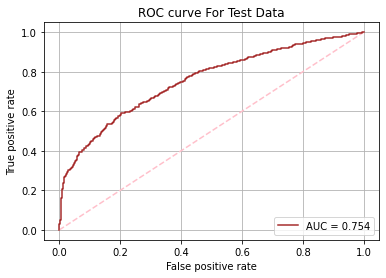

In [0]:
# Converting the DataFrame to Pandas to plot the ROC curve in the lines below
cv_Pred_Annual_pd = cv_Pred_Annual.select(['response', 'prediction', 'Probability List']).toPandas()

# Converting the probability column from dense vetor to a list 
cv_Pred_Annual_pd['Probability List'] = cv_Pred_Annual_pd['Probability List'].map(lambda x: list(x))
cv_Pred_Annual_pd['encoded_label'] = cv_Pred_Annual_pd['response'].map(lambda x: np.eye(2)[int(x)])

# Defining y_pred and y_true 
y_pred = np.array(cv_Pred_Annual_pd['Probability List'].tolist())
y_true = np.array(cv_Pred_Annual_pd['encoded_label'].tolist())

# Finding False Positive Rate and True Positive Rate
fpr, tpr, threshold = roc_curve(y_score=y_pred[:,0], y_true=y_true[:,0])
AUC = auc(fpr, tpr)

# Defining the plot
plt.figure()

plt.plot([0,1], [0,1], 'k--', color='pink')
plt.plot(fpr, tpr, label='AUC = {:.3f}'.format(AUC), color='brown')

# Defining the x and y lables + the title
plt.xlabel('False positive rate')
plt.ylabel('True positive rate')
plt.title('ROC curve For Test Data')
plt.legend(loc='lower right')
plt.grid() # Set the grid layout of the plot on 
plt.show()

Plotting the ROC curve for the Train Data

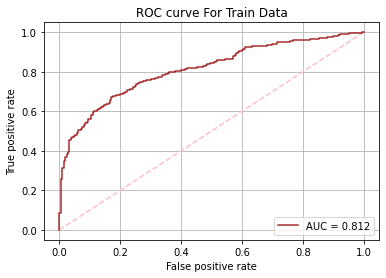

In [0]:
# Transforming the train dataset in order to plot the ROC curve 
cv_Train_Pred_Annual = cv_Model_Annual.transform(TrainDF_Annual)

# Converting the Spark DataFrame to a Panada DataFrame 
cv_Train_Pred_Annual_pd = cv_Train_Pred_Annual .select(['response', 'prediction', 'probability']).toPandas()

# Converting the probability column from dense vetor to a list 
cv_Train_Pred_Annual_pd['probability'] = cv_Train_Pred_Annual_pd['probability'].map(lambda x: list(x))
cv_Train_Pred_Annual_pd['encoded_label'] = cv_Train_Pred_Annual_pd['response'].map(lambda x: np.eye(2)[int(x)])

# Defining y_pred and y_true 
y_pred = np.array(cv_Train_Pred_Annual_pd['probability'].tolist())
y_true = np.array(cv_Train_Pred_Annual_pd['encoded_label'].tolist())

# Finding False Positive Rate and True Positive Rate
fpr, tpr, threshold = roc_curve(y_score=y_pred[:,0], y_true=y_true[:,0])
AUC = auc(fpr, tpr)

# Defining the x and y lables + the title
plt.figure()
plt.plot([0,1], [0,1], 'k--', color='pink')
plt.plot(fpr, tpr, label='AUC = {:.3f}'.format(AUC), color= "brown")
plt.xlabel('False positive rate')
plt.ylabel('True positive rate')
plt.title('ROC curve For Train Data')
plt.legend(loc='lower right')
plt.grid()
plt.show()

Plotting The Confusion Matrix

In [0]:
Confusion_Matrix_lr = confusion_matrix(np.array(cv_Pred_Annual.select("label").collect()), np.array(cv_Pred_Annual.select("prediction").collect()))
print (Confusion_Matrix_lr)

[[2878 1273]
 [ 146  291]]


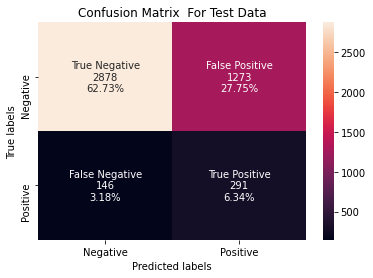

In [0]:
# Using SNS Heat Map to plot the confusion matrix

ax= plt.subplot()

# Defining the names in the heatmap
group_names = ['True Negative','False Positive','False Negative','True Positive']

group_counts = ["{0:0.0f}".format(value) for value in Confusion_Matrix_lr.flatten()]
group_percentages = ["{0:.2%}".format(value) for value in Confusion_Matrix_lr.flatten()/np.sum(Confusion_Matrix_lr)]
labels = [f"{v1}\n{v2}\n{v3}" for v1, v2, v3 in zip(group_names,group_counts,group_percentages)]
labels = np.asarray(labels).reshape(2,2)

# Plotting the heat map in accordance to the confusion matrix for the linear regression model
sns.heatmap(Confusion_Matrix_lr,annot=labels, fmt='')

# Naming the axis and axis ticks
ax.set_xlabel('Predicted labels'); ax.set_ylabel('True labels');
ax.xaxis.set_ticklabels(['Negative', 'Positive']); ax.yaxis.set_ticklabels(['Negative', 'Positive']);

# Naming the heatmap title 
plt.title('Confusion Matrix  For Test Data')

plt.show()

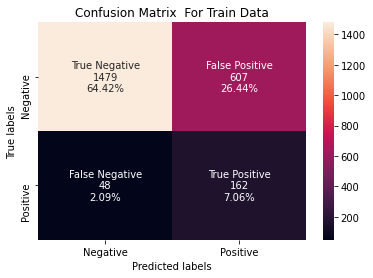

In [0]:
# Confusion Matrix for the Train data 

Confusion_Matrix_lr_train = confusion_matrix(np.array(cv_Train_Pred_Annual.select("label").collect()), np.array(cv_Train_Pred_Annual.select("prediction").collect()))

# Using SNS Heat Map to plot the confusion matrix

ax= plt.subplot()

# Defining the names in the heatmap
group_names = ['True Negative','False Positive','False Negative','True Positive']

group_counts = ["{0:0.0f}".format(value) for value in Confusion_Matrix_lr_train.flatten()]
group_percentages = ["{0:.2%}".format(value) for value in Confusion_Matrix_lr_train.flatten()/np.sum(Confusion_Matrix_lr_train)]
labels = [f"{v1}\n{v2}\n{v3}" for v1, v2, v3 in zip(group_names,group_counts,group_percentages)]
labels = np.asarray(labels).reshape(2,2)

# Plotting the heat map in accordance to the confusion matrix for the linear regression model
sns.heatmap(Confusion_Matrix_lr_train,annot=labels, fmt='')

# Naming the axis and axis ticks
ax.set_xlabel('Predicted labels'); ax.set_ylabel('True labels');
ax.xaxis.set_ticklabels(['Negative', 'Positive']); ax.yaxis.set_ticklabels(['Negative', 'Positive']);

# Naming the heatmap title 
plt.title('Confusion Matrix  For Train Data')

plt.show()


Calculating Precision And Recall.

In [0]:
# Displaying the prediction and Actual values (Target/label Variable)
display(cv_Pred_Annual.select("prediction", "response"))

prediction,response
0.0,0.0
0.0,0.0
1.0,0.0
0.0,0.0
0.0,0.0
0.0,0.0
1.0,0.0
1.0,0.0
0.0,0.0
0.0,0.0


In [0]:
# Calculating true positive, true negative, false positive, false negative
tp = cv_Pred_Annual[(cv_Pred_Annual.response == 1) & (cv_Pred_Annual.prediction == 1)].count()
print ("True Positive is Equal to:", tp)
tn = cv_Pred_Annual[(cv_Pred_Annual.response == 0) & (cv_Pred_Annual.prediction == 0)].count()
print ("True Negative is Equal to:", tn)
fp = cv_Pred_Annual[(cv_Pred_Annual.response == 0) & (cv_Pred_Annual.prediction == 1)].count()
print ("False Positive is Equal to:", fp)
fn = cv_Pred_Annual[(cv_Pred_Annual.response == 1) & (cv_Pred_Annual.prediction == 0)].count()
print ("False Negative is Equal to:", fn)
print("-----------------------------------")

True Positive is Equal to: 291
True Negative is Equal to: 2878
False Positive is Equal to: 1273
False Negative is Equal to: 146
-----------------------------------


In [0]:
# Calculating precision and recall for the different classes of the test set 
from pyspark.mllib.evaluation import MulticlassMetrics
predictionAndLabels = cv_Pred_Annual.select('prediction', 'response')
metrics = MulticlassMetrics(predictionAndLabels.rdd.map(lambda x: tuple(map(float, x))))

print("Recall for Class 0:", metrics.recall(0.0))
print("Recall for Class 1:", metrics.recall(1.0))
print("Precision for Class 0:", metrics.precision(0.0))
print("Precision for Class 1:", metrics.precision(1.0))
print("Accuracy:", metrics.accuracy)

Recall for Class 0: 0.6933269091785113
Recall for Class 1: 0.665903890160183
Precision for Class 0: 0.9517195767195767
Precision for Class 1: 0.1860613810741688
Accuracy: 0.6907149084568439


In [0]:
# Self-Check
# Printing the classification report for the Test Data
# Importing relevant library 
from sklearn.metrics import classification_report

cv_Pred_Annual_pd['prediction']
cv_Pred_Annual_pd['response']

Class_Report = classification_report(cv_Pred_Annual_pd['response'], cv_Pred_Annual_pd['prediction'], target_names = ['Class 0 (-ve response)','Class 1 (+ve response)'])
print(Class_Report)

                        precision    recall  f1-score   support

Class 0 (-ve response)       0.95      0.69      0.80      4151
Class 1 (+ve response)       0.19      0.67      0.29       437

              accuracy                           0.69      4588
             macro avg       0.57      0.68      0.55      4588
          weighted avg       0.88      0.69      0.75      4588



#### Decision Tree for the Annual Dataset

#### 4- Fitting the training dataset and optimizing the hyperparameters of the method.

In [0]:
# Defining the model
dt = DecisionTreeClassifier(featuresCol="features", labelCol="label", weightCol="weight", minInstancesPerNode=100)

In [0]:
# Defining the pipeline based on the stages created in previous steps. 
pipeline_dt = Pipeline(stages=[stringIndexer, encoder, labelToIndex, vecAssembler, dt])

Hyperparameter Tuning 

I used cross validation with 3 folds to tune the hyperparameter.

In [0]:
# Defining ParamGridBuilder to do a grid search over the set of model's hyperparameters.
paramGrid_dt = (ParamGridBuilder()
                .addGrid(dt.maxDepth, [5, 10, 25]) \
                .addGrid(dt.maxBins, [10, 20, 30]) \
                .build())

In [0]:
# Create a 3-fold CrossValidator
cv_Annual_dt = CrossValidator(estimator=pipeline_dt, estimatorParamMaps=paramGrid_dt, evaluator=bcEvaluator, numFolds=3, parallelism = 4, seed = 1147)
 
# Running cross validations. The code below will return the best model with the optimal hyperparameter found from the cross validation.
cv_Model_Annual_dt = cv_Annual_dt.fit(TrainDF_Annual)

Making predictions and evaluating model performance

In [0]:
# Using the model identified by the cross-validation to make predictions on the test dataset
cv_Pred_Annual_dt = cv_Model_Annual_dt.transform(TestDF_Annual)

# Finding the area under the ROC curve and accuracy  
print(f"Area under ROC curve: {bcEvaluator.evaluate(cv_Pred_Annual_dt)}") 
print(f"Accuracy: {mcEvaluator.evaluate(cv_Pred_Annual_dt)}")

Area under ROC curve: 0.7377506012997889
Accuracy: 0.6170444638186574


#### 5- Plotting feature importance.

In [0]:
# Plotting the feature importance values 

dt_Annual_Feature_Imp = cv_Model_Annual_dt.bestModel.stages[-1].featureImportances  # Finding the Featrue Importance of the Decision Tree Model

dt_Annual_Feature_lsit = list([float(w) for w in dt_Annual_Feature_Imp])            # Converting the Sparse vector to a list 
print("Length of the Feature Importance List", len(dt_Annual_Feature_lsit))

# Making a dataframe of the Features of the Annual Data of the decision tree model 
rdd1 = sc.parallelize(dt_Annual_Feature_lsit) # using parallelize() to convert the list to an RDD

# Applying the transformation function (lambda) on every element of the RDD
dt_Annual_Feature_Table=sqlContext.createDataFrame(rdd1.map(lambda x: Row(x)),['Feature Importances'])

# Plotting Feature Importance of the annaul dataset for the Decision Tree Model
# (use the bar plot in the display options)
dt_Annual_Feature_Table.display()

Length of the Feature Importance List 75


Feature Importances
0.018642775858362368
0.0
0.0
0.0
0.0
0.0
0.0
0.05470043838314123
0.0
0.0


#### 6- Plotting probability distribution for test set

binary: 0 for clients who responded negatively to the promotional campaign and 1 for clients who responded positively to the campaign.

In [0]:
# Converting the probability column from a Dense vector to an array 
cv_Pred_Annual_dt = cv_Pred_Annual_dt.withColumn('Probability List', vector_to_array('probability'))

# Selecting only the positive probailities of the clients reponses (Converting the probability to % by multiplying it by 100)
cv_Pred_Annual_dt = cv_Pred_Annual_dt.withColumn("Positive Probability", cv_Pred_Annual_dt["Probability List"].getItem(1)*100)

cv_Pred_Annual_dt.select("Positive Probability").display() 
# (use the histogram plot in the display options)
print("Histogram of the % of the Positive Client Response Probability")

Positive Probability
4.551007941356144
27.04174228675138
32.112068965517246
27.04174228675138
4.551007941356144
4.551007941356144
77.06318866651675
65.00379362670714
4.551007941356144
27.04174228675138


Histogram of the % of the Positive Client Response Probability


#### 7- Plotting confusion matrix and ROC curves of train/test set. Calculating precision/recall.

Plotting the ROC Curve for the "Test Data"

In [0]:
# Converting the DataFrame to Pandas to plot the ROC curve in the lines below
cv_Pred_Annual_dt_pd = cv_Pred_Annual_dt.select(['response', 'prediction', 'Probability List']).toPandas()
cv_Pred_Annual_dt_pd.head()

,response,prediction,Probability List
0,0.0,0.0,"[0.9544899205864384, 0.045510079413561444]"
1,0.0,0.0,"[0.7295825771324863, 0.2704174228675138]"
2,0.0,0.0,"[0.6788793103448275, 0.32112068965517243]"
3,0.0,0.0,"[0.7295825771324863, 0.2704174228675138]"
4,0.0,0.0,"[0.9544899205864384, 0.045510079413561444]"


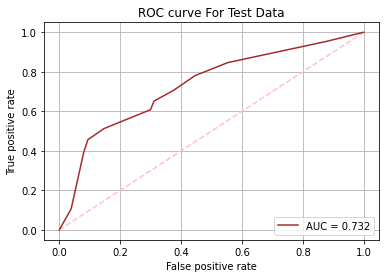

In [0]:
# Converting the probability column from dense vetor to a list 
cv_Pred_Annual_dt_pd['Probability List'] = cv_Pred_Annual_dt_pd['Probability List'].map(lambda x: list(x))
cv_Pred_Annual_dt_pd['encoded_label'] = cv_Pred_Annual_dt_pd['response'].map(lambda x: np.eye(2)[int(x)])

# Defining y_pred and y_true 
y_pred = np.array(cv_Pred_Annual_dt_pd['Probability List'].tolist())
y_true = np.array(cv_Pred_Annual_dt_pd['encoded_label'].tolist())

# Importing relavent Library 
from sklearn.metrics import auc, roc_curve
# Finding False Positive Rate and True Positive Rate
fpr, tpr, threshold = roc_curve(y_score=y_pred[:,0], y_true=y_true[:,0])
AUC = auc(fpr, tpr)

# Defining the plot
plt.figure()

plt.plot([0,1], [0,1], 'k--', color='pink')
plt.plot(fpr, tpr, label='AUC = {:.3f}'.format(AUC), color='brown')

# Defining the x and y lables + the title
plt.xlabel('False positive rate')
plt.ylabel('True positive rate')
plt.title('ROC curve For Test Data')
plt.legend(loc='lower right')
plt.grid() # Set the grid layout of the plot on 
plt.show()

# https://swan-gallery.web.cern.ch/notebooks/apache_spark1/ML_Spark_MLlib.html

Plotting the ROC Curve for the "Train Data"

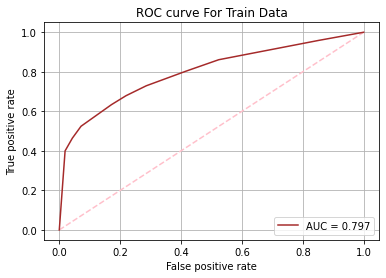

In [0]:
# Transforming the train dataset in order to plot the ROC curve 
cv_Train_Pred_Annual_dt = cv_Model_Annual_dt.transform(TrainDF_Annual)

# Converting the Spark DataFrame to a Panada DataFrame 
cv_Train_Pred_Annual_dt_pd = cv_Train_Pred_Annual_dt.select(['response', 'prediction', 'probability']).toPandas()

# Converting the probability column from dense vetor to a list 
cv_Train_Pred_Annual_dt_pd['probability'] = cv_Train_Pred_Annual_dt_pd['probability'].map(lambda x: list(x))
cv_Train_Pred_Annual_dt_pd['encoded_label'] = cv_Train_Pred_Annual_dt_pd['response'].map(lambda x: np.eye(2)[int(x)])

# Defining y_pred and y_true 
y_pred = np.array(cv_Train_Pred_Annual_dt_pd['probability'].tolist())
y_true = np.array(cv_Train_Pred_Annual_dt_pd['encoded_label'].tolist())

# Finding False Positive Rate and True Positive Rate
fpr, tpr, threshold = roc_curve(y_score=y_pred[:,0], y_true=y_true[:,0])
AUC = auc(fpr, tpr)

# Defining the x and y lables + the title
plt.figure()
plt.plot([0,1], [0,1], 'k--', color='pink')
plt.plot(fpr, tpr, label='AUC = {:.3f}'.format(AUC), color='brown')
plt.xlabel('False positive rate')
plt.ylabel('True positive rate')
plt.title('ROC curve For Train Data')
plt.legend(loc='lower right')
plt.grid() # Set the grid layout of the plot on 
plt.show()

Plotting the Confusion Matrix

In [0]:
Confusion_Matrix_dt = confusion_matrix(np.array(cv_Pred_Annual_dt.select("label").collect()), np.array(cv_Pred_Annual_dt.select("prediction").collect()))
print (Confusion_Matrix_dt)

[[2525 1626]
 [ 131  306]]


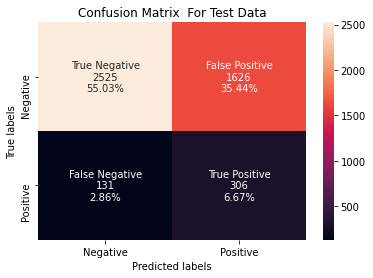

In [0]:
# Using SNS Heat Map to plot the confusion matrix
ax= plt.subplot()

# Defining the names in the heatmap
group_names = ['True Negative','False Positive','False Negative','True Positive']
group_counts = ["{0:0.0f}".format(value) for value in Confusion_Matrix_dt.flatten()]
group_percentages = ["{0:.2%}".format(value) for value in Confusion_Matrix_dt.flatten()/np.sum(Confusion_Matrix_dt)]
labels = [f"{v1}\n{v2}\n{v3}" for v1, v2, v3 in zip(group_names,group_counts,group_percentages)]
labels = np.asarray(labels).reshape(2,2)

# Plotting the heat map in accordance to the confusion matrix for the Decision Tree Model
sns.heatmap(Confusion_Matrix_dt,annot=labels, fmt='')

# Naming the axis and axis ticks and heatmap title
ax.set_xlabel('Predicted labels');ax.set_ylabel('True labels');
ax.xaxis.set_ticklabels(['Negative', 'Positive']); ax.yaxis.set_ticklabels(['Negative', 'Positive']);
plt.title('Confusion Matrix  For Test Data')

plt.show()

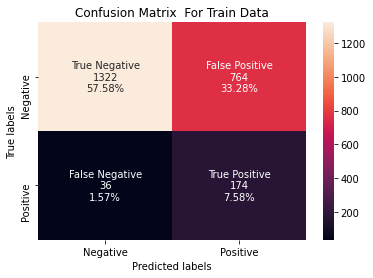

In [0]:
# Confusion Matrix for the Train data set 

Confusion_Matrix_dt_train = confusion_matrix(np.array(cv_Train_Pred_Annual_dt.select("label").collect()), np.array(cv_Train_Pred_Annual_dt.select("prediction").collect()))

# Using SNS Heat Map to plot the confusion matrix
ax= plt.subplot()

# Defining the names in the heatmap
group_names = ['True Negative','False Positive','False Negative','True Positive']
group_counts = ["{0:0.0f}".format(value) for value in Confusion_Matrix_dt_train.flatten()]
group_percentages = ["{0:.2%}".format(value) for value in Confusion_Matrix_dt_train.flatten()/np.sum(Confusion_Matrix_dt_train)]
labels = [f"{v1}\n{v2}\n{v3}" for v1, v2, v3 in zip(group_names,group_counts,group_percentages)]
labels = np.asarray(labels).reshape(2,2)

# Plotting the heat map in accordance to the confusion matrix for the Decision Tree Model
sns.heatmap(Confusion_Matrix_dt_train,annot=labels, fmt='')

# Naming the axis and axis ticks and heatmap title
ax.set_xlabel('Predicted labels');ax.set_ylabel('True labels');
ax.xaxis.set_ticklabels(['Negative', 'Positive']); ax.yaxis.set_ticklabels(['Negative', 'Positive']);
plt.title('Confusion Matrix  For Train Data')

plt.show()

Calculating Precision And Recall.

In [0]:
# Displaying the prediction and Actual values (Target/label Variable)
display(cv_Pred_Annual_dt.select("prediction", "response"))

prediction,response
0.0,0.0
0.0,0.0
0.0,0.0
0.0,0.0
0.0,0.0
0.0,0.0
1.0,0.0
1.0,0.0
0.0,0.0
0.0,0.0


In [0]:
# Calculating true positive, true negative, false positive, false negative, Recall
tp = cv_Pred_Annual_dt[(cv_Pred_Annual_dt.response == 1) & (cv_Pred_Annual_dt.prediction == 1)].count()
print ("True Positive is Equal to:", tp)
tn = cv_Pred_Annual_dt[(cv_Pred_Annual_dt.response == 0) & (cv_Pred_Annual_dt.prediction == 0)].count()
print ("True Negative is Equal to:", tn)
fp = cv_Pred_Annual_dt[(cv_Pred_Annual_dt.response == 0) & (cv_Pred_Annual_dt.prediction == 1)].count()
print ("False Positive is Equal to:", fp)
fn = cv_Pred_Annual_dt[(cv_Pred_Annual_dt.response == 1) & (cv_Pred_Annual_dt.prediction == 0)].count()
print ("False Negative is Equal to:", fn)
print("-----------------------------------")

True Positive is Equal to: 306
True Negative is Equal to: 2525
False Positive is Equal to: 1626
False Negative is Equal to: 131
-----------------------------------


In [0]:
# Calculating precision and recall for the different classes of the test set 
predictionAndLabels = cv_Pred_Annual_dt.select('prediction', 'response')
metrics = MulticlassMetrics(predictionAndLabels.rdd.map(lambda x: tuple(map(float, x))))

print("Recall for Class 0:", metrics.recall(0.0))
print("Recall for Class 1:", metrics.recall(1.0))
print("Precision for Class 0:", metrics.precision(0.0))
print("Precision for Class 1:", metrics.precision(1.0))
print("Accuracy:", metrics.accuracy)

Recall for Class 0: 0.6082871597205493
Recall for Class 1: 0.700228832951945
Precision for Class 0: 0.9506777108433735
Precision for Class 1: 0.15838509316770186
Accuracy: 0.6170444638186574


In [0]:
# Self-check
# Printing the classification report for the Test Data

cv_Pred_Annual_dt_pd['prediction']
cv_Pred_Annual_dt_pd['response']

Class_Report = classification_report(cv_Pred_Annual_dt_pd['response'], cv_Pred_Annual_dt_pd['prediction'], target_names = ['Class 0 (-ve response)','Class 1 (+ve response)'])
print(Class_Report)

                        precision    recall  f1-score   support

Class 0 (-ve response)       0.95      0.61      0.74      4151
Class 1 (+ve response)       0.16      0.70      0.26       437

              accuracy                           0.62      4588
             macro avg       0.55      0.65      0.50      4588
          weighted avg       0.88      0.62      0.70      4588



#### Random Forest For Annual Data

#### 4- Fitting the training dataset and optimizing the hyperparameters of the method.

In [0]:
# Defining the model
rf = RandomForestClassifier(featuresCol = 'features', labelCol = 'label', weightCol="weight", minInstancesPerNode=100)

In [0]:
# Defining the pipeline based on the stages created in previous steps. 
pipeline_rf = Pipeline(stages=[stringIndexer, encoder, labelToIndex, vecAssembler, rf])

Hyperparameter Tuning

I used cross validation with 3 folds to tune the hyperparameter.

In [0]:
# Defining ParamGridBuilder to do a grid search over the set of model's hyperparameters.
paramGrid_rf = (ParamGridBuilder() \
            .addGrid(rf.maxDepth, [5, 10, 15]) \
            .addGrid(rf.numTrees, [10, 20]) \
            .build())

In [0]:
# Create a 3-fold CrossValidator
cv_Annual_rf = CrossValidator(estimator=pipeline_rf, estimatorParamMaps = paramGrid_rf, evaluator = bcEvaluator, numFolds=3, parallelism = 4, seed = 1147)
 
# Running cross validations. The code below will return the best model with the optimal hyperparameter found from the cross validation.
cv_Model_Annual_rf = cv_Annual_rf.fit(TrainDF_Annual)

In [0]:
# Using the model identified by the cross-validation to make predictions on the test dataset
cv_Pred_Annual_rf = cv_Model_Annual_rf.transform(TestDF_Annual)

# Finding the area under the ROC curve and accuracy  
print(f"Area under ROC curve: {bcEvaluator.evaluate(cv_Pred_Annual_rf)}") 
print(f"Accuracy: {mcEvaluator.evaluate(cv_Pred_Annual_rf)}")

Area under ROC curve: 0.759303401843565
Accuracy: 0.6839581517000872


#### 5- Plotting feature importance.

In [0]:
# Plotting the feature importance values 

rf_Annual_Imp = cv_Model_Annual_rf.bestModel.stages[-1].featureImportances # Finding the Featrue Importance of the Random Forest Model 

rf_Annual_Imp_lsit = list([float(w) for w in rf_Annual_Imp])               # Converting the Sparse vector to a list 
print("Length of the Feature Importance List", len(rf_Annual_Imp_lsit))

# Making a dataframe of the Features of the Annual Data of the Random Forest Model 
rdd_rf = sc.parallelize(rf_Annual_Imp_lsit) # using parallelize() to convert the list to an RDD

# Applying the transformation function (lambda) on every element of the RDD
rf_Annual_Imp_Table=sqlContext.createDataFrame(rdd_rf.map(lambda x: Row(x)),['Feature Importances'])

# Plotting Feature Importance of the annaul dataset for the Random Forest Model 
# # (use the bar plot in the display options)
rf_Annual_Imp_Table.display()

Length of the Feature Importance List 75


Feature Importances
0.0036278427158836475
0.012257135962105484
0.0025227526647619643
0.004050127847059518
0.005846184136887993
0.0037985758348122014
0.022535119677917066
0.0
0.003179257568591528
0.0016934949923697814


#### 6- Plotting probability distribution for test set

In [0]:
# Converting the probability column from a Dense vector to an array 
cv_Pred_Annual_rf = cv_Pred_Annual_rf.withColumn('Probability List', vector_to_array('probability'))

# Selecting only the positive probailities of the clients reponses (Converting the probability to % by multiplying it by 100)
cv_Pred_Annual_rf = cv_Pred_Annual_rf.withColumn("Positive Probability", cv_Pred_Annual_rf["Probability List"].getItem(1)*100)

cv_Pred_Annual_rf.select("Positive Probability").display() # (use the histogram plot in the display options)
print("Histogram of the % of the Positive Client Response Probability")

Positive Probability
14.780981609772997
19.24479366532194
40.66639142241598
19.039459407768593
14.960637992162546
19.635482101834718
62.748614463928675
61.471698154950595
25.091413833860006
14.905007745588714


Histogram of the % of the Positive Client Response Probability


#### 7- Plotting confusion matrix and ROC curves of train/test set. Calculating precision/recall.

Plotting the Confusion Matrix

In [0]:
Confusion_Matrix_rf = confusion_matrix(np.array(cv_Pred_Annual_rf.select("label").collect()), np.array(cv_Pred_Annual_rf.select("prediction").collect()))

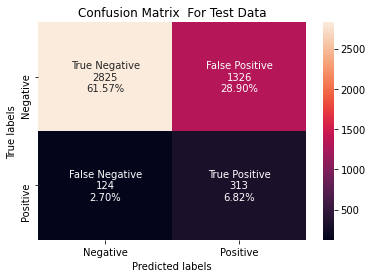

In [0]:
# Using SNS Heat Map to plot the confusion matrix
ax= plt.subplot()

# Defining the names in the heatmap
group_names = ['True Negative','False Positive','False Negative','True Positive']
group_counts = ["{0:0.0f}".format(value) for value in Confusion_Matrix_rf.flatten()]
group_percentages = ["{0:.2%}".format(value) for value in Confusion_Matrix_rf.flatten()/np.sum(Confusion_Matrix_rf)]
labels = [f"{v1}\n{v2}\n{v3}" for v1, v2, v3 in zip(group_names,group_counts,group_percentages)]
labels = np.asarray(labels).reshape(2,2)

# Plotting the heat map in accordance to the confusion matrix for the Random Forest Model
sns.heatmap(Confusion_Matrix_rf,annot=labels, fmt='')

# Naming the axis and axis ticks and heatmap title
ax.set_xlabel('Predicted labels');ax.set_ylabel('True labels');
ax.xaxis.set_ticklabels(['Negative', 'Positive']); ax.yaxis.set_ticklabels(['Negative', 'Positive']);
plt.title('Confusion Matrix  For Test Data')

plt.show()

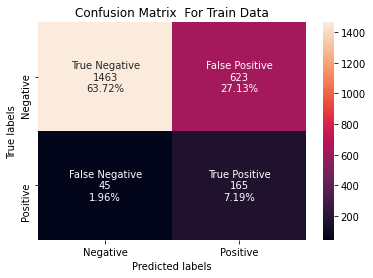

In [0]:
# Confusion Matrix for the Train dataset 

cv_Train_Pred_Annual_rf = cv_Model_Annual_rf.transform(TrainDF_Annual)

Confusion_Matrix_rf_train = confusion_matrix(np.array(cv_Train_Pred_Annual_rf.select("label").collect()), np.array(cv_Train_Pred_Annual_rf.select("prediction").collect()))

# Using SNS Heat Map to plot the confusion matrix
ax= plt.subplot()

# Defining the names in the heatmap
group_names = ['True Negative','False Positive','False Negative','True Positive']
group_counts = ["{0:0.0f}".format(value) for value in Confusion_Matrix_rf_train.flatten()]
group_percentages = ["{0:.2%}".format(value) for value in Confusion_Matrix_rf_train.flatten()/np.sum(Confusion_Matrix_rf_train)]
labels = [f"{v1}\n{v2}\n{v3}" for v1, v2, v3 in zip(group_names,group_counts,group_percentages)]
labels = np.asarray(labels).reshape(2,2)

# Plotting the heat map in accordance to the confusion matrix for the Random Forest Model
sns.heatmap(Confusion_Matrix_rf_train,annot=labels, fmt='')

# Naming the axis and axis ticks and heatmap title
ax.set_xlabel('Predicted labels');ax.set_ylabel('True labels');
ax.xaxis.set_ticklabels(['Negative', 'Positive']); ax.yaxis.set_ticklabels(['Negative', 'Positive']);
plt.title('Confusion Matrix  For Train Data')

plt.show()

Plotting the ROC Curve for the "Test Data"

In [0]:
# Converting the DataFrame to Pandas to plot the ROC curve in the lines below
cv_Pred_Annual_rf_pd = cv_Pred_Annual_rf.select(['response', 'prediction', 'Probability List']).toPandas()
cv_Pred_Annual_rf_pd.head()

,response,prediction,Probability List
0,0.0,0.0,"[0.85219018390227, 0.14780981609772997]"
1,0.0,0.0,"[0.8075520633467808, 0.19244793665321938]"
2,0.0,0.0,"[0.5933360857758402, 0.40666391422415976]"
3,0.0,0.0,"[0.809605405922314, 0.1903945940776859]"
4,0.0,0.0,"[0.8503936200783746, 0.14960637992162545]"


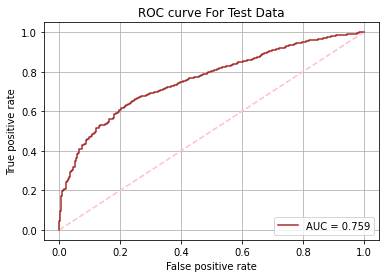

In [0]:
# Converting the probability column from dense vetor to a list 
cv_Pred_Annual_rf_pd['Probability List'] = cv_Pred_Annual_rf_pd['Probability List'].map(lambda x: list(x))
cv_Pred_Annual_rf_pd['encoded_label'] = cv_Pred_Annual_rf_pd['response'].map(lambda x: np.eye(2)[int(x)])

# Defining y_pred and y_true 
y_pred = np.array(cv_Pred_Annual_rf_pd['Probability List'].tolist())
y_true = np.array(cv_Pred_Annual_rf_pd['encoded_label'].tolist())

# Finding False Positive Rate and True Positive Rate
fpr, tpr, threshold = roc_curve(y_score=y_pred[:,0], y_true=y_true[:,0])
AUC = auc(fpr, tpr)

# Defining the plot
plt.figure()
plt.plot([0,1], [0,1], 'k--', color='pink')
plt.plot(fpr, tpr, label='AUC = {:.3f}'.format(AUC), color = 'brown')

# Defining the x and y lables + the title
plt.xlabel('False positive rate')
plt.ylabel('True positive rate')
plt.title('ROC curve For Test Data')
plt.legend(loc='lower right')
plt.grid()
plt.show()

Plotting the ROC Curve for the "Train Data"

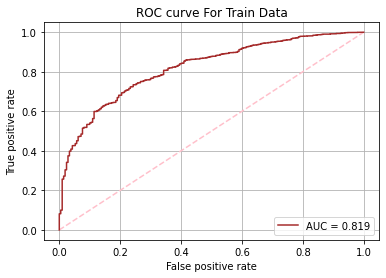

In [0]:
# Transforming the train dataset in order to plot the ROC curve 
cv_Train_Pred_Annual_rf = cv_Model_Annual_rf.transform(TrainDF_Annual)

# Converting the Spark DataFrame to a Panada DataFrame 
cv_Train_Pred_Annual_rf_pd = cv_Train_Pred_Annual_rf.select(['response', 'prediction', 'probability']).toPandas()

# Converting the probability column from dense vetor to a list 
cv_Train_Pred_Annual_rf_pd['probability'] = cv_Train_Pred_Annual_rf_pd['probability'].map(lambda x: list(x))
cv_Train_Pred_Annual_rf_pd['encoded_label'] = cv_Train_Pred_Annual_rf_pd['response'].map(lambda x: np.eye(2)[int(x)])

# Defining y_pred and y_true 
y_pred = np.array(cv_Train_Pred_Annual_rf_pd['probability'].tolist())
y_true = np.array(cv_Train_Pred_Annual_rf_pd['encoded_label'].tolist())

# Finding False Positive Rate and True Positive Rate
fpr, tpr, threshold = roc_curve(y_score=y_pred[:,0], y_true=y_true[:,0])
AUC = auc(fpr, tpr)

# Defining the x and y lables + the title
plt.figure()
plt.plot([0,1], [0,1], 'k--', color='pink')
plt.plot(fpr, tpr, label='AUC = {:.3f}'.format(AUC), color= "brown")
plt.xlabel('False positive rate')
plt.ylabel('True positive rate')
plt.title('ROC curve For Train Data')
plt.legend(loc='lower right')
plt.grid()
plt.show()

Calculating Precision and Recall

In [0]:
display(cv_Pred_Annual_rf.select("prediction", "response"))

prediction,response
0.0,0.0
0.0,0.0
0.0,0.0
0.0,0.0
0.0,0.0
0.0,0.0
1.0,0.0
1.0,0.0
0.0,0.0
0.0,0.0


In [0]:
# Calculating true positive, true negative, false positive, false negative, Recall
tp = cv_Pred_Annual_rf[(cv_Pred_Annual_rf.response == 1) & (cv_Pred_Annual_rf.prediction == 1)].count()
print ("True Positive is Equal to:", tp)
tn = cv_Pred_Annual_rf[(cv_Pred_Annual_rf.response == 0) & (cv_Pred_Annual_rf.prediction == 0)].count()
print ("True Negative is Equal to:", tn)
fp = cv_Pred_Annual_rf[(cv_Pred_Annual_rf.response == 0) & (cv_Pred_Annual_rf.prediction == 1)].count()
print ("False Positive is Equal to:", fp)
fn = cv_Pred_Annual_rf[(cv_Pred_Annual_rf.response == 1) & (cv_Pred_Annual_rf.prediction == 0)].count()
print ("False Negative is Equal to:", fn)
print("-----------------------------------")

True Positive is Equal to: 313
True Negative is Equal to: 2825
False Positive is Equal to: 1326
False Negative is Equal to: 124
-----------------------------------


In [0]:
# Calculating precision and recall for the different classes of the test set 
predictionAndLabels = cv_Pred_Annual_rf.select('prediction', 'response')
metrics = MulticlassMetrics(predictionAndLabels.rdd.map(lambda x: tuple(map(float, x))))

print("Recall for Class 0:", metrics.recall(0.0))
print("Recall for Class 1:", metrics.recall(1.0))
print("Precision for Class 0:", metrics.precision(0.0))
print("Precision for Class 1:", metrics.precision(1.0))
print("Accuracy:", metrics.accuracy)

Recall for Class 0: 0.6805589014695255
Recall for Class 1: 0.7162471395881007
Precision for Class 0: 0.9579518480840963
Precision for Class 1: 0.19097010372178158
Accuracy: 0.6839581517000872


In [0]:
# Self-Check
# Printing the classification report for the Test Data

cv_Pred_Annual_rf_pd['prediction']
cv_Pred_Annual_rf_pd['response']

Class_Report = classification_report(cv_Pred_Annual_rf_pd['response'], cv_Pred_Annual_rf_pd['prediction'], target_names = ['Class 0 (-ve response)','Class 1 (+ve response)'])
print(Class_Report)

                        precision    recall  f1-score   support

Class 0 (-ve response)       0.96      0.68      0.80      4151
Class 1 (+ve response)       0.19      0.72      0.30       437

              accuracy                           0.68      4588
             macro avg       0.57      0.70      0.55      4588
          weighted avg       0.88      0.68      0.75      4588



### CALCULATIONS FOR MONTHLY DATASET

##### BALANCING THE DATA

In [0]:
# Finding the counts of the Target variable in the Annual Train dataset 
TrainDF_Monthly.select("response").groupBy("response").count().collect()

Out[96]: [Row(response=1.0, count=10165), Row(response=0.0, count=97735)]

In [0]:
# Since the dataset is imbalanced, I will balance the dataset

y_collect = TrainDF_Monthly.select("response").groupBy("response").count().collect()

# Finding the unique values in the target variable. In the case we have a binary target variable being either "0" or "1"
unique_y = [x["response"] for x in y_collect]
total_y = sum([x["count"] for x in y_collect])
unique_y_count = len(y_collect)
bin_count = [x["count"] for x in y_collect]

# In Pyspark, in the training set, each row requires to have a weight assinged to it. 
# The mapping here does this (applies a weight to each row of the training set)

class_weights_spark = {i: ii for i, ii in zip(unique_y, total_y / (unique_y_count * np.array(bin_count)))}
mapping_expr = F.create_map([F.lit(x) for x in chain(*class_weights_spark.items())])

TrainDF_Monthly = TrainDF_Monthly.withColumn("weight", mapping_expr.getItem(F.col("response")))

display(TrainDF_Monthly)

day_since_last_txn,Friday,Monday,Saturday,Sunday,Thursday,Tuesday,Wednesday,response,mth_txn_amt_sum_imputed,mth_txn_cnt_imputed,mth_txn_sum_3M_imputed,mth_txn_mean_3M_imputed,mth_txn_max_3M_imputed,mth_txn_cnt_sum_3M_imputed,mth_txn_cnt_mean_3M_imputed,mth_txn_cnt_max_3M_imputed,mth_txn_sum_6M_imputed,mth_txn_mean_6M_imputed,mth_txn_max_6M_imputed,mth_txn_cnt_sum_6M_imputed,mth_txn_cnt_mean_6M_imputed,mth_txn_cnt_max_6M_imputed,mth_txn_sum_12M_imputed,mth_txn_mean_12M_imputed,mth_txn_max_12M_imputed,mth_txn_cnt_sum_12M_imputed,mth_txn_cnt_mean_12M_imputed,mth_txn_cnt_max_12M_imputed,weight
0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,35.0,1.0,35.0,11.666667,35.0,1.0,0.33333334,1.0,99.0,16.5,64.0,2.0,0.33333334,1.0,99.0,8.25,64.0,2.0,0.16666667,1.0,0.5520028648897529
0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,36.0,1.0,36.0,12.0,36.0,1.0,0.33333334,1.0,168.0,28.0,86.0,3.0,0.5,1.0,286.0,23.833334,101.0,5.0,0.41666666,2.0,0.5520028648897529
0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,38.0,1.0,38.0,12.666667,38.0,1.0,0.33333334,1.0,116.0,19.333334,43.0,3.0,0.5,1.0,286.0,23.833334,101.0,5.0,0.41666666,2.0,0.5520028648897529
0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,48.0,1.0,48.0,16.0,48.0,1.0,0.33333334,1.0,48.0,8.0,48.0,1.0,0.16666667,1.0,380.0,31.666666,118.0,6.0,0.5,2.0,0.5520028648897529
0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,58.0,1.0,126.0,42.0,68.0,2.0,0.6666667,1.0,329.0,54.833332,165.0,5.0,0.8333333,2.0,329.0,27.416666,165.0,5.0,0.41666666,2.0,0.5520028648897529
0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,59.0,1.0,59.0,19.666666,59.0,1.0,0.33333334,1.0,59.0,9.833333,59.0,1.0,0.16666667,1.0,261.0,21.75,79.0,4.0,0.33333334,1.0,0.5520028648897529
0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,65.0,1.0,145.0,48.333332,80.0,2.0,0.6666667,1.0,271.0,45.166668,126.0,4.0,0.6666667,2.0,448.0,37.333332,126.0,6.0,0.5,2.0,0.5520028648897529
0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,67.0,1.0,67.0,22.333334,67.0,1.0,0.33333334,1.0,95.0,15.833333,67.0,2.0,0.33333334,1.0,95.0,7.9166665,67.0,2.0,0.16666667,1.0,0.5520028648897529
0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,82.0,1.0,82.0,27.333334,82.0,1.0,0.33333334,1.0,82.0,13.666667,82.0,1.0,0.16666667,1.0,234.0,19.5,82.0,3.0,0.25,1.0,0.5520028648897529
0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,89.0,1.0,188.0,62.666668,99.0,2.0,0.6666667,1.0,135.0,22.5,83.0,2.0,0.33333334,1.0,286.0,23.833334,101.0,5.0,0.41666666,2.0,0.5520028648897529


#### 3- Pre-process.

In [0]:
# Finding and printing all the Categorical Features: 
Categorical_Features_Month = [field for (field, dataType) in TrainDF_Monthly.dtypes if dataType == "string"]
# Finding and printing all the Numerical Features: 
Numerical_Features_Month = [field for (field, dataType) in TrainDF_Monthly.dtypes if ((dataType == "float") & (field != "response"))]

# The two lines of code (below) are estimators. These two estimators will return functions that will later be applied to a transform dataset.
stringIndexer = StringIndexer(inputCols=Categorical_Features_Month, outputCols=[x + "Index" for x in Categorical_Features_Month]) 
encoder = OneHotEncoder(inputCols=stringIndexer.getOutputCols(), outputCols=[x + "OHE" for x in Categorical_Features_Month]) 
 
# Converting the target column to a numerical values. 
labelToIndex = StringIndexer(inputCol="response", outputCol="label")

# Combining all the feature columns names into "assemblerInputs"
assemblerInputs = [c + "OHE" for c in Categorical_Features_Month] + Numerical_Features_Month

# Feature Transformation:
# ML Models requires the set of features to be in a single vector. 
# To do So I will use Vector Assembler. Vector Assembler combines all the features into one column (single vector).
vecAssembler = VectorAssembler(inputCols= assemblerInputs, outputCol="features")

#### 4- Fitting the training dataset and optimizing the hyperparameters of the method.

#### Logistic with L1 regularization for Monthly Dataset

In [0]:
lr_Month = LogisticRegression (featuresCol = "features", labelCol = "label", weightCol="weight",  standardization = True, elasticNetParam = 1)

Hyperparameter tuning

I used cross validation with 3 folds to tune the hyperparameter.

In [0]:
# Defining ParamGridBuilder to do a grid search over the set of model's hyperparameters.
paramGrid_M_lr = (ParamGridBuilder()
                  .addGrid(lr.regParam, [0.01, 0.5, 2.0])
                  .build())

In [0]:
# Defining the pipeline 
pipeline_lr_Month = Pipeline(stages=[stringIndexer, encoder, labelToIndex, vecAssembler, lr_Month])

In [0]:
# Create a 3-fold CrossValidator
cv_Month_lr = CrossValidator(estimator=pipeline_lr_Month, estimatorParamMaps=paramGrid_M_lr, evaluator=bcEvaluator, numFolds=3, parallelism = 4, seed = 1147)
 
# Run cross validations. The code below will return the best model with the optimal hyperparameter found from the cross validation.
cv_Model_Month_lr= cv_Month_lr.fit(TrainDF_Monthly)


In [0]:
# Using the model identified by the cross-validation to make predictions on the test dataset
cv_Pred_Month_lr = cv_Model_Month_lr.transform(TestDF_Monthly)

# Finding the area under the ROC curve and accuracy 
print(f"Area under ROC curve: {bcEvaluator.evaluate(cv_Pred_Month_lr)}") 
print(f"Accuracy: {mcEvaluator.evaluate(cv_Pred_Month_lr)}")

Area under ROC curve: 0.6374203664243031
Accuracy: 0.6353131028342484


#### 5- Plotting coefficient values.

In [0]:
# Plotting the coefficient values 

LR_Month_Coeff = cv_Model_Month_lr.bestModel.stages[-1].coefficients # Finding the coefficients of the logistic regression model

LR_Month_Coeff_lsit = list([float(w) for w in LR_Month_Coeff]) # Converting the Sparse vector to a list 
print("Length of the Coefficient List", len(LR_Month_Coeff_lsit))

# Making a dataframe of the coefficients of the Monthly Data of the logisitic regression model 
rdd_Month_lr = sc.parallelize(LR_Month_Coeff_lsit) # using parallelize() to convert the list to an RDD

# Applying the transformation function (lambda) on every element of the RDD
LR_Month_Coeff_Table=sqlContext.createDataFrame(rdd_Month_lr.map(lambda x: Row(x)),['Feature Coefficients'])

# Plotting coefficients of the annaul dataset for the logistic regression model
LR_Month_Coeff_Table.display()
# Please use the bar plot option below the displayed table to view the bar plot

Length of the Coefficient List 28


Feature Coefficients
-8.3060151724747E-4
-0.014132591321059852
-0.06159762079941
-0.08882176310118531
-0.0031456947550808157
-0.032474850782974414
-0.12038254179553087
-0.007627781488903297
8.11995755924481E-4
-0.045373829452797464


#### 6- Plotting probability distribution for test set.

In [0]:
print(cv_Pred_Month_lr.schema["probability"].dataType) # Finding the data type for probability column 
print('Number of Rows of the cv_Pred_Annual table are: ', cv_Pred_Month_lr.count()) # Finding the number of rows of the prob

VectorUDT
Number of Rows of the cv_Pred_Annual table are:  215648


In [0]:
# Converting the probability column from a Dense vector to an array 
cv_Pred_Month_lr = cv_Pred_Month_lr.withColumn('Probability List', vector_to_array('probability'))

# selection only the positive probailities of the clients reponses (Converting the probability to % by multiplying it by 100)
cv_Pred_Month_lr = cv_Pred_Month_lr.withColumn("Positive Probability", cv_Pred_Month_lr["Probability List"].getItem(1)*100)

cv_Pred_Month_lr.select("Positive Probability").display() # (use the histogram plot in the display options)
print("Histogram of the % of the Positive Client Response Probability")

Positive Probability
47.763018655738776
34.69653857560184
50.26098556906155
47.64515162073463
50.879494631473264
49.1226206862465
50.11789953146133
48.603321872312776
49.20972281116286
72.79091675758015


Histogram of the % of the Positive Client Response Probability


#### 7- Plotting confusion matrix and ROC curves of train/test set. Calculating precision/recall.

Plotting the ROC curve for the "Test Data"

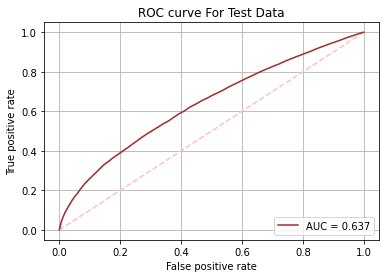

In [0]:
# Converting the DataFrame to Pandas to plot the ROC curve in the lines below
cv_Pred_Month_lr_pd = cv_Pred_Month_lr.select(['response', 'prediction', 'Probability List']).toPandas()

# Converting the probability column from dense vetor to a list 
cv_Pred_Month_lr_pd['Probability List'] = cv_Pred_Month_lr_pd['Probability List'].map(lambda x: list(x))
cv_Pred_Month_lr_pd['encoded_label'] = cv_Pred_Month_lr_pd['response'].map(lambda x: np.eye(2)[int(x)])

# Defining y_pred and y_true 
y_pred = np.array(cv_Pred_Month_lr_pd['Probability List'].tolist())
y_true = np.array(cv_Pred_Month_lr_pd['encoded_label'].tolist())

# Finding False Positive Rate and True Positive Rate
fpr, tpr, threshold = roc_curve(y_score=y_pred[:,0], y_true=y_true[:,0])
AUC = auc(fpr, tpr)

# Defining the plot
plt.figure()

plt.plot([0,1], [0,1], 'k--', color='pink')
plt.plot(fpr, tpr, label='AUC = {:.3f}'.format(AUC), color='brown')

# Defining the x and y lables + the title
plt.xlabel('False positive rate')
plt.ylabel('True positive rate')
plt.title('ROC curve For Test Data')
plt.legend(loc='lower right')
plt.grid() # Set the grid layout of the plot on 
plt.show()

Plotting the ROC curve for the Train Data

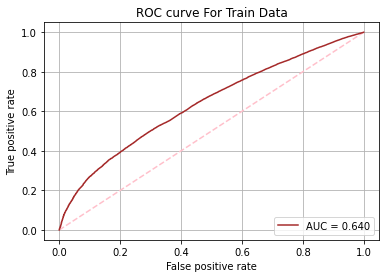

In [0]:
# Transforming the train dataset in order to plot the ROC curve 
cv_Pred_Month_Train_lr = cv_Model_Month_lr.transform(TrainDF_Monthly)

# Converting the Spark DataFrame to a Panada DataFrame 
cv_Pred_Month_Train_lr_pd = cv_Pred_Month_Train_lr .select(['response', 'prediction', 'probability']).toPandas()

# Converting the probability column from dense vetor to a list 
cv_Pred_Month_Train_lr_pd['probability'] = cv_Pred_Month_Train_lr_pd['probability'].map(lambda x: list(x))
cv_Pred_Month_Train_lr_pd['encoded_label'] = cv_Pred_Month_Train_lr_pd['response'].map(lambda x: np.eye(2)[int(x)])

# Defining y_pred and y_true 
y_pred = np.array(cv_Pred_Month_Train_lr_pd['probability'].tolist())
y_true = np.array(cv_Pred_Month_Train_lr_pd['encoded_label'].tolist())

# Finding False Positive Rate and True Positive Rate
fpr, tpr, threshold = roc_curve(y_score=y_pred[:,0], y_true=y_true[:,0])
AUC = auc(fpr, tpr)

# Defining the x and y lables + the title
plt.figure()
plt.plot([0,1], [0,1], 'k--', color='pink')
plt.plot(fpr, tpr, label='AUC = {:.3f}'.format(AUC), color= "brown")
plt.xlabel('False positive rate')
plt.ylabel('True positive rate')
plt.title('ROC curve For Train Data')
plt.legend(loc='lower right')
plt.grid()
plt.show()

Plotting The Confusion Matrix

In [0]:
Confusion_Matrix_Month_lr = confusion_matrix(np.array(cv_Pred_Month_lr.select("label").collect()), np.array(cv_Pred_Month_lr.select("prediction").collect()))
print (Confusion_Matrix_Month_lr)

[[126042  69362]
 [  9282  10962]]


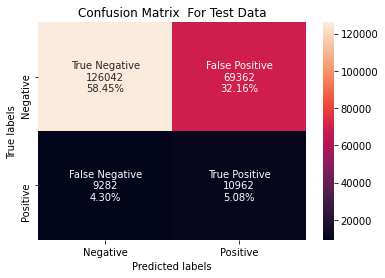

In [0]:
# Using SNS Heat Map to plot the confusion matrix
ax= plt.subplot()

# Defining the names in the heatmap
group_names = ['True Negative','False Positive','False Negative','True Positive']
group_counts = ["{0:0.0f}".format(value) for value in Confusion_Matrix_Month_lr.flatten()]
group_percentages = ["{0:.2%}".format(value) for value in Confusion_Matrix_Month_lr.flatten()/np.sum(Confusion_Matrix_Month_lr)]
labels = [f"{v1}\n{v2}\n{v3}" for v1, v2, v3 in zip(group_names,group_counts,group_percentages)]
labels = np.asarray(labels).reshape(2,2)

# Plotting the heat map in accordance to the confusion matrix for the linear regression model
sns.heatmap(Confusion_Matrix_Month_lr,annot=labels, fmt='')

# Naming the axis and axis ticks and title 
ax.set_xlabel('Predicted labels');ax.set_ylabel('True labels');
ax.xaxis.set_ticklabels(['Negative', 'Positive']); ax.yaxis.set_ticklabels(['Negative', 'Positive']);
plt.title('Confusion Matrix  For Test Data')

plt.show()

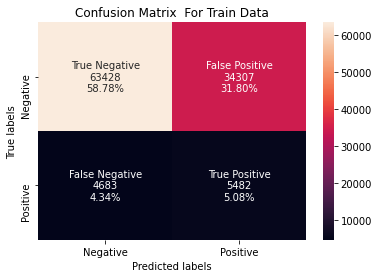

In [0]:
# Plotting Confusion Matrix for the train data 

Confusion_Matrix_Month_lr_train = confusion_matrix(np.array(cv_Pred_Month_Train_lr.select("label").collect()), np.array(cv_Pred_Month_Train_lr.select("prediction").collect()))

# Using SNS Heat Map to plot the confusion matrix
ax= plt.subplot()

# Defining the names in the heatmap
group_names = ['True Negative','False Positive','False Negative','True Positive']
group_counts = ["{0:0.0f}".format(value) for value in Confusion_Matrix_Month_lr_train.flatten()]
group_percentages = ["{0:.2%}".format(value) for value in Confusion_Matrix_Month_lr_train.flatten()/np.sum(Confusion_Matrix_Month_lr_train)]
labels = [f"{v1}\n{v2}\n{v3}" for v1, v2, v3 in zip(group_names,group_counts,group_percentages)]
labels = np.asarray(labels).reshape(2,2)

# Plotting the heat map in accordance to the confusion matrix for the linear regression model
sns.heatmap(Confusion_Matrix_Month_lr_train,annot=labels, fmt='')

# Naming the axis and axis ticks and title 
ax.set_xlabel('Predicted labels');ax.set_ylabel('True labels');
ax.xaxis.set_ticklabels(['Negative', 'Positive']); ax.yaxis.set_ticklabels(['Negative', 'Positive']);
plt.title('Confusion Matrix  For Train Data')

plt.show()

Calculating Precision and Recall.

In [0]:
display(cv_Pred_Month_lr.select("prediction", "response"))

prediction,response
0.0,0.0
0.0,0.0
1.0,0.0
0.0,0.0
1.0,0.0
0.0,0.0
1.0,0.0
0.0,0.0
0.0,0.0
1.0,0.0


In [0]:
# Calculating true positive, true negative, false positive, false negative, Recall
tp = cv_Pred_Month_lr[(cv_Pred_Month_lr.response == 1) & (cv_Pred_Month_lr.prediction == 1)].count()
print ("True Positive is Equal to:", tp)
tn = cv_Pred_Month_lr[(cv_Pred_Month_lr.response == 0) & (cv_Pred_Month_lr.prediction == 0)].count()
print ("True Negative is Equal to:", tn)
fp = cv_Pred_Month_lr[(cv_Pred_Month_lr.response == 0) & (cv_Pred_Month_lr.prediction == 1)].count()
print ("False Positive is Equal to:", fp)
fn = cv_Pred_Month_lr[(cv_Pred_Month_lr.response == 1) & (cv_Pred_Month_lr.prediction == 0)].count()
print ("False Negative is Equal to:", fn)
print("-----------------------------------")

True Positive is Equal to: 10962
True Negative is Equal to: 126042
False Positive is Equal to: 69362
False Negative is Equal to: 9282
-----------------------------------


In [0]:
# Calculating precision and recall for the different classes of the test set 
predictionAndLabels = cv_Pred_Month_lr.select('prediction', 'response')
metrics = MulticlassMetrics(predictionAndLabels.rdd.map(lambda x: tuple(map(float, x))))

print("Recall for Class 0:", metrics.recall(0.0))
print("Recall for Class 1:", metrics.recall(1.0))
print("Precision for Class 0:", metrics.precision(0.0))
print("Precision for Class 1:", metrics.precision(1.0))
print("Accuracy:", metrics.accuracy)

Recall for Class 0: 0.6450328550080858
Recall for Class 1: 0.5414937759336099
Precision for Class 0: 0.9314090626939789
Precision for Class 1: 0.1364722872366914
Accuracy: 0.6353131028342484


In [0]:
# Self-Check
# Printing the classification report for the Test Data

cv_Pred_Month_lr_pd['prediction']
cv_Pred_Month_lr_pd['response']

Class_Report = classification_report(cv_Pred_Month_lr_pd['response'], cv_Pred_Month_lr_pd['prediction'], target_names = ['Class 0 (-ve response)','Class 1 (+ve response)'])
print(Class_Report)

                        precision    recall  f1-score   support

Class 0 (-ve response)       0.93      0.65      0.76    195404
Class 1 (+ve response)       0.14      0.54      0.22     20244

              accuracy                           0.64    215648
             macro avg       0.53      0.59      0.49    215648
          weighted avg       0.86      0.64      0.71    215648



#### Decision Tree for the Montly Dataset

#### 4- Fitting the training dataset and optimizing the hyperparameters of the method.

In [0]:
# Defining the model
dt_Month = DecisionTreeClassifier(featuresCol="features", labelCol="label", weightCol="weight", maxDepth=3, minInstancesPerNode=100)

In [0]:
# Defining the pipeline based on the stages created in previous steps. 
pipeline_dt_Month = Pipeline(stages=[stringIndexer, encoder, labelToIndex, vecAssembler, dt_Month])

Hyperparameter Tuning

I used cross validation with 3 folds to tune the hyperparameter.

In [0]:
# Defining ParamGridBuilder to do a grid search over the set of model's hyperparameters.
paramGrid_dt_Month = (ParamGridBuilder()
                      .addGrid(dt_Month.maxDepth, [10, 20, 30]) \
                      .addGrid(dt_Month.maxBins, [300, 400, 500]) \
                      .build())

In [0]:
# Create a 3-fold CrossValidator
cv_Month_dt = CrossValidator(estimator=pipeline_dt_Month, estimatorParamMaps=paramGrid_dt_Month, evaluator=bcEvaluator, numFolds=3, parallelism = 4, seed = 1147)

# Running cross validations. The code below will return the best model with the optimal hyperparameter found from the cross validation.
cv_Model_Month_dt = cv_Month_dt.fit(TrainDF_Monthly)

In [0]:
# Using the model identified by the cross-validation to make predictions on the test dataset
cv_Pred_Month_dt = cv_Model_Month_dt.transform(TestDF_Monthly)

# Finding the area under the ROC curve and accuracy 
print(f"Area under ROC curve: {bcEvaluator.evaluate(cv_Pred_Month_dt)}") 
print(f"Accuracy: {mcEvaluator.evaluate(cv_Pred_Month_dt)}")

Area under ROC curve: 0.5530010144633257
Accuracy: 0.5406356655290102


In [0]:
# Plotting the feature importance values 

dt_Month_Feature = cv_Model_Month_dt.bestModel.stages[-1].featureImportances # Finding the feature of the decision tree model

dt_Month_Feature_lsit = list([float(w) for w in dt_Month_Feature]) # Converting the Sparse vector to a list 
print("Length of the Feature Importance List", len(dt_Month_Feature_lsit))

# Making a dataframe of the features of the Monthly Data of the Decision Tree model 
rdd_Month_dt = sc.parallelize(dt_Month_Feature_lsit) # using parallelize() to convert the list to an RDD

# Applying the transformation function (lambda) on every element of the RDD
dt_Month_Feat_Table=sqlContext.createDataFrame(rdd_Month_dt.map(lambda x: Row(x)),['Feature Importances'])

# Plotting coefficients of the annaul dataset (use the bar plot in the display options)
dt_Month_Feat_Table.display()

Length of the Feature Importance List 28


Feature Importances
0.04627546196028641
0.0
0.003075184578683705
0.0
0.0
0.002237187749750517
0.0
0.0
0.01131997105179581
0.0035726423962899197


#### 6- Plotting probability distribution for test set.

In [0]:
# Converting the probability column from a Dense vector to an array 
cv_Pred_Month_dt = cv_Pred_Month_dt.withColumn('Probability List', vector_to_array('probability'))

# Selecting only the positive probailities of the clients reponses (Converting the probability to % by multiplying it by 100)
cv_Pred_Month_dt = cv_Pred_Month_dt.withColumn("Positive Probability", cv_Pred_Month_dt["Probability List"].getItem(1)*100)

cv_Pred_Month_dt.select("Positive Probability").display() # (use the histogram plot in the display options)
print("Histogram of the % of the Positive Client Response Probability")

Positive Probability
46.962484481247216
35.95701970811479
46.962484481247216
40.23586283664016
46.962484481247216
37.32806268039438
46.962484481247216
57.506430977629094
46.962484481247216
66.58933748218075


Histogram of the % of the Positive Client Response Probability


#### 7- Plotting confusion matrix and ROC curves of train/test set. Calculating precision/recall.

Plotting the ROC Curve for the "Test Data"

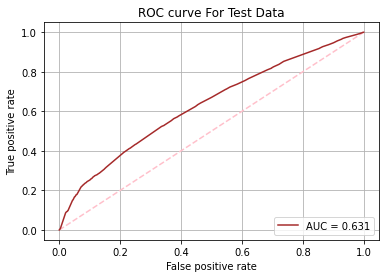

In [0]:
# Converting the DataFrame to Pandas to plot the ROC curve in the lines below
cv_Pred_Month_dt_pd = cv_Pred_Month_dt.select(['response', 'prediction', 'Probability List']).toPandas()

# Converting the probability column from dense vetor to a list 
cv_Pred_Month_dt_pd['Probability List'] = cv_Pred_Month_dt_pd['Probability List'].map(lambda x: list(x))
cv_Pred_Month_dt_pd['encoded_label'] = cv_Pred_Month_dt_pd['response'].map(lambda x: np.eye(2)[int(x)])

# Defining y_pred and y_true 
y_pred = np.array(cv_Pred_Month_dt_pd['Probability List'].tolist())
y_true = np.array(cv_Pred_Month_dt_pd['encoded_label'].tolist())

# Finding False Positive Rate and True Positive Rate
fpr, tpr, threshold = roc_curve(y_score=y_pred[:,0], y_true=y_true[:,0])
AUC = auc(fpr, tpr)

# Defining the plot
plt.figure()
plt.plot([0,1], [0,1], 'k--', color='pink')
plt.plot(fpr, tpr, label='AUC = {:.3f}'.format(AUC), color = "brown")

# Defining the x and y lables + the title
plt.xlabel('False positive rate')
plt.ylabel('True positive rate')
plt.title('ROC curve For Test Data')
plt.legend(loc='lower right')
plt.grid()
plt.show()

Plotting the ROC Curve for the "Train Data"

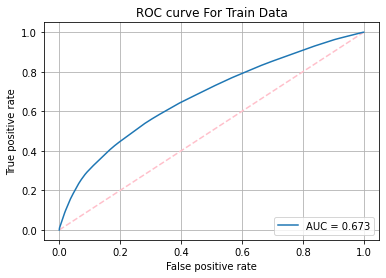

In [0]:
# Transforming the train dataset in order to plot the ROC curve 
cv_Train_Pred_Month_dt = cv_Model_Month_dt.transform(TrainDF_Monthly)

# Converting the Spark DataFrame to a Panada DataFrame 
cv_Train_Pred_Month_dt_pd = cv_Train_Pred_Month_dt.select(['response', 'prediction', 'probability']).toPandas()

# Converting the probability column from dense vetor to a list 
cv_Train_Pred_Month_dt_pd['probability'] = cv_Train_Pred_Month_dt_pd['probability'].map(lambda x: list(x))
cv_Train_Pred_Month_dt_pd['encoded_label'] = cv_Train_Pred_Month_dt_pd['response'].map(lambda x: np.eye(2)[int(x)])

# Defining y_pred and y_true 
y_pred = np.array(cv_Train_Pred_Month_dt_pd['probability'].tolist())
y_true = np.array(cv_Train_Pred_Month_dt_pd['encoded_label'].tolist())

# Finding False Positive Rate and True Positive Rate
fpr, tpr, threshold = roc_curve(y_score=y_pred[:,0], y_true=y_true[:,0])
AUC = auc(fpr, tpr)

# Defining the x and y lables + the title
plt.figure()
plt.plot([0,1], [0,1], 'k--', color='pink')
plt.plot(fpr, tpr, label='AUC = {:.3f}'.format(AUC))
plt.xlabel('False positive rate')
plt.ylabel('True positive rate')
plt.title('ROC curve For Train Data')
plt.legend(loc='lower right')
plt.grid()
plt.show()

Plotting the Confusion Matrix

In [0]:
Confusion_Matrix_dt_Month = confusion_matrix(np.array(cv_Pred_Month_dt.select("label").collect()), np.array(cv_Pred_Month_dt.select("prediction").collect()))
print (Confusion_Matrix_dt_Month)

[[103311  92093]
 [  6968  13276]]


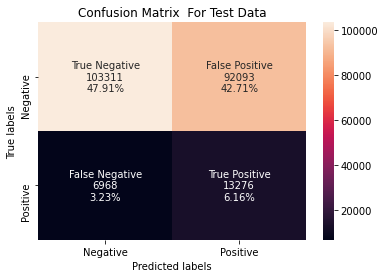

In [0]:
# Confusion matrix for the test data 
# Using SNS Heat Map to plot the confusion matrix
ax= plt.subplot()

# Defining the names in the heatmap
group_names = ['True Negative','False Positive','False Negative','True Positive']
group_counts = ["{0:0.0f}".format(value) for value in Confusion_Matrix_dt_Month.flatten()]
group_percentages = ["{0:.2%}".format(value) for value in Confusion_Matrix_dt_Month.flatten()/np.sum(Confusion_Matrix_dt_Month)]
labels = [f"{v1}\n{v2}\n{v3}" for v1, v2, v3 in zip(group_names,group_counts,group_percentages)]
labels = np.asarray(labels).reshape(2,2)

# Plotting the heat map in accordance to the confusion matrix for the linear regression model
sns.heatmap(Confusion_Matrix_dt_Month,annot=labels, fmt='')

# Naming the axis and axis ticks and heatmap title
ax.set_xlabel('Predicted labels');ax.set_ylabel('True labels');
ax.xaxis.set_ticklabels(['Negative', 'Positive']); ax.yaxis.set_ticklabels(['Negative', 'Positive']);
plt.title('Confusion Matrix  For Test Data')

plt.show()

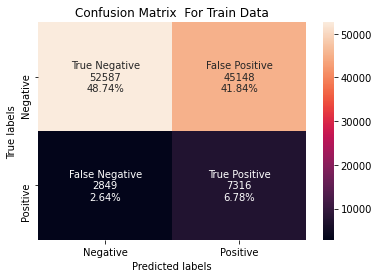

In [0]:
# Plotting the Confusion Matrix for the Train data 

Confusion_Matrix_dt_Month_train = confusion_matrix(np.array(cv_Train_Pred_Month_dt.select("label").collect()), np.array(cv_Train_Pred_Month_dt.select("prediction").collect()))

# Using SNS Heat Map to plot the confusion matrix
ax= plt.subplot()

# Defining the names in the heatmap
group_names = ['True Negative','False Positive','False Negative','True Positive']
group_counts = ["{0:0.0f}".format(value) for value in Confusion_Matrix_dt_Month_train.flatten()]
group_percentages = ["{0:.2%}".format(value) for value in Confusion_Matrix_dt_Month_train.flatten()/np.sum(Confusion_Matrix_dt_Month_train)]
labels = [f"{v1}\n{v2}\n{v3}" for v1, v2, v3 in zip(group_names,group_counts,group_percentages)]
labels = np.asarray(labels).reshape(2,2)

# Plotting the heat map in accordance to the confusion matrix for the linear regression model
sns.heatmap(Confusion_Matrix_dt_Month_train,annot=labels, fmt='')

# Naming the axis and axis ticks and heatmap title
ax.set_xlabel('Predicted labels');ax.set_ylabel('True labels');
ax.xaxis.set_ticklabels(['Negative', 'Positive']); ax.yaxis.set_ticklabels(['Negative', 'Positive']);
plt.title('Confusion Matrix  For Train Data')

plt.show()

Calculating Precision and Recall.

In [0]:
# Displaying the prediction and Actual values (Target/label Variable)
display(cv_Pred_Month_dt.select("prediction", "response"))

prediction,response
0.0,0.0
0.0,0.0
0.0,0.0
0.0,0.0
0.0,0.0
0.0,0.0
0.0,0.0
1.0,0.0
0.0,0.0
1.0,0.0


In [0]:
# Calculating true positive, true negative, false positive, false negative, Recall
tp = cv_Pred_Month_dt[(cv_Pred_Month_dt.response == 1) & (cv_Pred_Month_dt.prediction == 1)].count()
print ("True Positive is Equal to:", tp)
tn = cv_Pred_Month_dt[(cv_Pred_Month_dt.response == 0) & (cv_Pred_Month_dt.prediction == 0)].count()
print ("True Negative is Equal to:", tn)
fp = cv_Pred_Month_dt[(cv_Pred_Month_dt.response == 0) & (cv_Pred_Month_dt.prediction == 1)].count()
print ("False Positive is Equal to:", fp)
fn = cv_Pred_Month_dt[(cv_Pred_Month_dt.response == 1) & (cv_Pred_Month_dt.prediction == 0)].count()
print ("False Negative is Equal to:", fn)
print("-----------------------------------")

True Positive is Equal to: 13276
True Negative is Equal to: 103311
False Positive is Equal to: 92093
False Negative is Equal to: 6968
-----------------------------------


In [0]:
# Calculating precision and recall for the different classes of the test set 
predictionAndLabels = cv_Pred_Month_dt.select('prediction', 'response')
metrics = MulticlassMetrics(predictionAndLabels.rdd.map(lambda x: tuple(map(float, x))))

print("Recall for Class 0:", metrics.recall(0.0))
print("Recall for Class 1:", metrics.recall(1.0))
print("Precision for Class 0:", metrics.precision(0.0))
print("Precision for Class 1:", metrics.precision(1.0))
print("Accuracy:", metrics.accuracy)

Recall for Class 0: 0.5287046324537881
Recall for Class 1: 0.655799249160245
Precision for Class 0: 0.9368148060827537
Precision for Class 1: 0.1259953117140715
Accuracy: 0.5406356655290102


In [0]:
# Self-Check
# Printing the classification report for the Test Data

cv_Pred_Month_dt_pd['prediction']
cv_Pred_Month_dt_pd['response']

Class_Report = classification_report(cv_Pred_Month_dt_pd['response'], cv_Pred_Month_dt_pd['prediction'], target_names = ['Class 0 (-ve response)','Class 1 (+ve response)'])
print(Class_Report)

                        precision    recall  f1-score   support

Class 0 (-ve response)       0.94      0.53      0.68    195404
Class 1 (+ve response)       0.13      0.66      0.21     20244

              accuracy                           0.54    215648
             macro avg       0.53      0.59      0.44    215648
          weighted avg       0.86      0.54      0.63    215648



#### Random Forest Monthly data

#### 4- Fitting the training dataset and optimizing the hyperparameters of the method.

In [0]:
# Defining the model
rf_Month = RandomForestClassifier(featuresCol = 'features', labelCol = 'label', weightCol="weight", minInstancesPerNode=100)

In [0]:
# Defining the pipeline based on the stages created in previous steps. 
pipeline_rf_Month = Pipeline(stages=[stringIndexer, encoder, labelToIndex, vecAssembler, rf_Month])

Hyperparameter Tuning

I used cross validation with 3 folds to tune the hyperparameter.

In [0]:
# Defining ParamGridBuilder to do a grid search over the set of model's hyperparameters.
paramGrid_rf_Month = (ParamGridBuilder() \
                      .addGrid(rf_Month.maxDepth, [2, 4, 6]) \
                      .addGrid(rf_Month.numTrees, [10, 100]) \
                      .build())

In [0]:
# Create a 3-fold CrossValidator
cv_Month_rf = CrossValidator(estimator=pipeline_rf_Month, estimatorParamMaps = paramGrid_rf_Month, evaluator = bcEvaluator, numFolds=3, parallelism = 4, seed = 1147)

# Running cross validations. The code below will return the best model with the optimal hyperparameter found from the cross validation.
cv_Model_Month_rf = cv_Month_rf.fit(TrainDF_Monthly)

Making predictions and evaluating model performance

In [0]:
# Using the model identified by the cross-validation to make predictions on the test dataset
cv_Pred_Month_rf = cv_Model_Month_rf.transform(TestDF_Monthly)

# Finding the area under the ROC curve and accuracy
print(f"Area under ROC curve: {bcEvaluator.evaluate(cv_Pred_Month_rf)}") 
print(f"Accuracy: {mcEvaluator.evaluate(cv_Pred_Month_rf)}")

Area under ROC curve: 0.6424385898872915
Accuracy: 0.5423282386110699


In [0]:
# Plotting the feature importance values 

rf_Month_Imp = cv_Model_Month_rf.bestModel.stages[-1].featureImportances # Finding the Feature Importance of the rf model

rf_Month_Imp_lsit = list([float(w) for w in rf_Month_Imp]) # Converting the Sparse vector to a list 
print("Length of the Feature Importance List", len(rf_Month_Imp))

# Making a dataframe of the Features of the Monthly Data of the rf model 
rdd_rf_Month = sc.parallelize(rf_Month_Imp_lsit) # using parallelize() to convert the list to an RDD

# Applying the transformation function (lambda) on every element of the RDD
rf_Month_Imp_Table=sqlContext.createDataFrame(rdd_rf_Month.map(lambda x: Row(x)),['Feature Importances'])

# Plotting Feature Importance of the Monthly dataset for the rf model (use the bar plot in the display options)
rf_Month_Imp_Table.display()

Length of the Feature Importance List 28


Feature Importances
0.0042910172008704195
4.067266996086704E-4
5.532345250475359E-4
3.125249634690061E-4
3.5337338789656045E-4
1.609515651919743E-4
2.8098177338299737E-4
2.2758210778906152E-4
0.0038441647626982624
6.796001237548135E-4


#### 6- Plotting probability distribution for test set.

In [0]:
# Converting the probability column from a Dense vector to an array 
cv_Pred_Month_rf = cv_Pred_Month_rf.withColumn('Probability List', vector_to_array('probability'))

# Selecting only the positive probailities of the clients reponses (Converting the probability to % by multiplying it by 100)
cv_Pred_Month_rf = cv_Pred_Month_rf.withColumn("Positive Probability", cv_Pred_Month_rf["Probability List"].getItem(1)*100)

cv_Pred_Month_rf.select("Positive Probability").display() # (use the histogram plot in the display options)
print("Histogram of the % of the Positive Client Response Probability")

Positive Probability
49.32086890444402
31.837801164990697
48.5963310448513
50.094967882076816
52.19744109744248
51.629755672469216
49.82729264739394
55.60967647604894
49.668952161741785
64.87973956618026


Histogram of the % of the Positive Client Response Probability


#### 7- Plotting confusion matrix and ROC curves of train/test set. Calculating precision/recall.

Plotting the ROC Curve for the "Test Data"

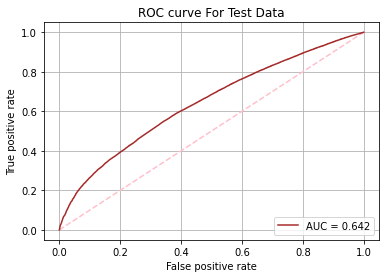

In [0]:
# Converting the DataFrame to Pandas to plot the ROC curve in the lines below
cv_Pred_Month_rf_pd = cv_Pred_Month_rf.select(['response', 'prediction', 'Probability List']).toPandas()

# Converting the probability column from dense vetor to a list 
cv_Pred_Month_rf_pd['Probability List'] = cv_Pred_Month_rf_pd['Probability List'].map(lambda x: list(x))
cv_Pred_Month_rf_pd['encoded_label'] = cv_Pred_Month_rf_pd['response'].map(lambda x: np.eye(2)[int(x)])

# Defining y_pred and y_true 
y_pred = np.array(cv_Pred_Month_rf_pd['Probability List'].tolist())
y_true = np.array(cv_Pred_Month_rf_pd['encoded_label'].tolist())

# Finding False Positive Rate and True Positive Rate
fpr, tpr, threshold = roc_curve(y_score=y_pred[:,0], y_true=y_true[:,0])
AUC = auc(fpr, tpr)

# Defining the plot
plt.figure()

plt.plot([0,1], [0,1], 'k--', color='pink')
plt.plot(fpr, tpr, label='AUC = {:.3f}'.format(AUC), color='brown')

# Defining the x and y lables + the title
plt.xlabel('False positive rate')
plt.ylabel('True positive rate')
plt.title('ROC curve For Test Data')
plt.legend(loc='lower right')
plt.grid() # Set the grid layout of the plot on 
plt.show()

Plotting the ROC Curve for the "Train Data"

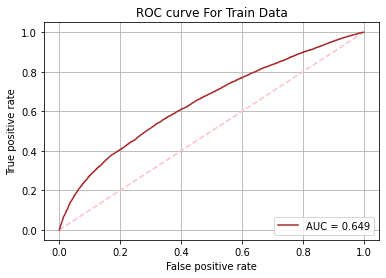

In [0]:
# Transforming the train dataset in order to plot the ROC curve 
cv_Pred_Month_rf_train = cv_Model_Month_rf.transform(TrainDF_Monthly)

# Converting the Spark DataFrame to a Panada DataFrame 
cv_Pred_Month_rf_train_pd = cv_Pred_Month_rf_train.select(['response', 'prediction', 'probability']).toPandas()

# Converting the probability column from dense vetor to a list 
cv_Pred_Month_rf_train_pd['probability'] = cv_Pred_Month_rf_train_pd['probability'].map(lambda x: list(x))
cv_Pred_Month_rf_train_pd['encoded_label'] = cv_Pred_Month_rf_train_pd['response'].map(lambda x: np.eye(2)[int(x)])

# Defining y_pred and y_true 
y_pred = np.array(cv_Pred_Month_rf_train_pd['probability'].tolist())
y_true = np.array(cv_Pred_Month_rf_train_pd['encoded_label'].tolist())

# Finding False Positive Rate and True Positive Rate
fpr, tpr, threshold = roc_curve(y_score=y_pred[:,0], y_true=y_true[:,0])
AUC = auc(fpr, tpr)

# Defining the x and y lables + the title
plt.figure()
plt.plot([0,1], [0,1], 'k--', color='pink')
plt.plot(fpr, tpr, label='AUC = {:.3f}'.format(AUC), color='brown')
plt.xlabel('False positive rate')
plt.ylabel('True positive rate')
plt.title('ROC curve For Train Data')
plt.legend(loc='lower right')
plt.grid() # Set the grid layout of the plot on 
plt.show()

Plotting the Confusion Matrix

In [0]:
Confusion_Matrix_rf_Month = confusion_matrix(np.array(cv_Pred_Month_rf.select("label").collect()), np.array(cv_Pred_Month_rf.select("prediction").collect()))

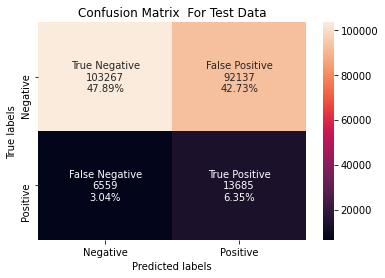

In [0]:
# Using SNS Heat Map to plot the confusion matrix
ax= plt.subplot()

# Defining the names in the heatmap
group_names = ['True Negative','False Positive','False Negative','True Positive']
group_counts = ["{0:0.0f}".format(value) for value in Confusion_Matrix_rf_Month.flatten()]
group_percentages = ["{0:.2%}".format(value) for value in Confusion_Matrix_rf_Month.flatten()/np.sum(Confusion_Matrix_rf_Month)]
labels = [f"{v1}\n{v2}\n{v3}" for v1, v2, v3 in zip(group_names,group_counts,group_percentages)]
labels = np.asarray(labels).reshape(2,2)

# Plotting the heat map in accordance to the confusion matrix for the linear regression model
sns.heatmap(Confusion_Matrix_rf_Month,annot=labels, fmt='')

# Naming the axis and axis ticks and heatmap title
ax.set_xlabel('Predicted labels');ax.set_ylabel('True labels');
ax.xaxis.set_ticklabels(['Negative', 'Positive']); ax.yaxis.set_ticklabels(['Negative', 'Positive']);
plt.title('Confusion Matrix  For Test Data')

plt.show()

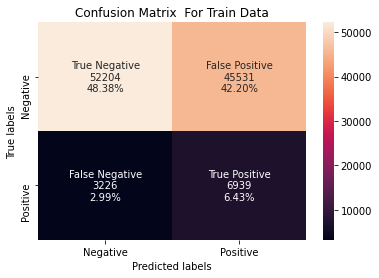

In [0]:
# Plotting the confusion matrix for the train data 
Confusion_Matrix_rf_Month_Train = confusion_matrix(np.array(cv_Pred_Month_rf_train.select("label").collect()), np.array(cv_Pred_Month_rf_train.select("prediction").collect()))


# Using SNS Heat Map to plot the confusion matrix
ax= plt.subplot()

# Defining the names in the heatmap
group_names = ['True Negative','False Positive','False Negative','True Positive']
group_counts = ["{0:0.0f}".format(value) for value in Confusion_Matrix_rf_Month_Train.flatten()]
group_percentages = ["{0:.2%}".format(value) for value in Confusion_Matrix_rf_Month_Train.flatten()/np.sum(Confusion_Matrix_rf_Month_Train)]
labels = [f"{v1}\n{v2}\n{v3}" for v1, v2, v3 in zip(group_names,group_counts,group_percentages)]
labels = np.asarray(labels).reshape(2,2)

# Plotting the heat map in accordance to the confusion matrix for the linear regression model
sns.heatmap(Confusion_Matrix_rf_Month_Train,annot=labels, fmt='')

# Naming the axis and axis ticks and heatmap title
ax.set_xlabel('Predicted labels');ax.set_ylabel('True labels');
ax.xaxis.set_ticklabels(['Negative', 'Positive']); ax.yaxis.set_ticklabels(['Negative', 'Positive']);
plt.title('Confusion Matrix  For Train Data')

plt.show()

Calculating Precision And Recall.

In [0]:
# Displaying the prediction and Actual values (Target/label Variable)
display(cv_Pred_Month_rf.select("prediction", "response"))

prediction,response
0.0,0.0
0.0,0.0
0.0,0.0
1.0,0.0
1.0,0.0
1.0,0.0
0.0,0.0
1.0,0.0
0.0,0.0
1.0,0.0


In [0]:
# Calculating true positive, true negative, false positive, false negative, Recall
tp = cv_Pred_Month_rf[(cv_Pred_Month_rf.response == 1) & (cv_Pred_Month_rf.prediction == 1)].count()
print ("True Positive is Equal to:", tp)
tn = cv_Pred_Month_rf[(cv_Pred_Month_rf.response == 0) & (cv_Pred_Month_rf.prediction == 0)].count()
print ("True Negative is Equal to:", tn)
fp = cv_Pred_Month_rf[(cv_Pred_Month_rf.response == 0) & (cv_Pred_Month_rf.prediction == 1)].count()
print ("False Positive is Equal to:", fp)
fn = cv_Pred_Month_rf[(cv_Pred_Month_rf.response == 1) & (cv_Pred_Month_rf.prediction == 0)].count()
print ("False Negative is Equal to:", fn)
print("-----------------------------------")

True Positive is Equal to: 13685
True Negative is Equal to: 103267
False Positive is Equal to: 92137
False Negative is Equal to: 6559
-----------------------------------


In [0]:
# Calculating precision and recall for the different classes of the test set 
predictionAndLabels = cv_Pred_Month_rf.select('prediction', 'response')
metrics = MulticlassMetrics(predictionAndLabels.rdd.map(lambda x: tuple(map(float, x))))

print("Recall for Class 0:", metrics.recall(0.0))
print("Recall for Class 1:", metrics.recall(1.0))
print("Precision for Class 0:", metrics.precision(0.0))
print("Precision for Class 1:", metrics.precision(1.0))
print("Accuracy:", metrics.accuracy)

Recall for Class 0: 0.5284794579435426
Recall for Class 1: 0.676002766251729
Precision for Class 0: 0.9402782583359132
Precision for Class 1: 0.12932093515526072
Accuracy: 0.5423282386110699


In [0]:
# Self-Check
# Printing the classification report for the Test Data

cv_Pred_Month_rf_pd['prediction']
cv_Pred_Month_rf_pd['response']

Class_Report = classification_report(cv_Pred_Month_rf_pd['response'], cv_Pred_Month_rf_pd['prediction'], target_names = ['Class 0 (-ve response)','Class 1 (+ve response)'])
print(Class_Report)

                        precision    recall  f1-score   support

Class 0 (-ve response)       0.94      0.53      0.68    195404
Class 1 (+ve response)       0.13      0.68      0.22     20244

              accuracy                           0.54    215648
             macro avg       0.53      0.60      0.45    215648
          weighted avg       0.86      0.54      0.63    215648



#### 1.3 Comparison of methods

Comparing the two feature engineering (annual and monthly) and the three modeling approaches (L1 log-reg, tree, forests) in terms of outcomes and selecting the best combination of feature engineering and modeling approach.

#### The outputs for each model and each dataset are summarized in the tables below:

**Step#5: Summary of the coefficient values or feature importance plots for the 3 different methods and 2 different feature engineering datasets**


| **Model Approaches**  |  **Annual Data**   | **Monthly Data** |
| :-------------:     |  :-------------:  | :-------------: |
| L1 log-reg        | ![This is an image](https://raw.githubusercontent.com/A2Keyan/CHE-1148-Assignment3-Figures/93901ea8a23ee9c95135b953fa9b52f9bad41ea0/Coeff%20Plot%20LR%20Annual.png)    | ![This is an image](https://raw.githubusercontent.com/A2Keyan/CHE-1148-Assignment3-Figures/main/Coeff%20Plot%20LR%20Month.png)   |
| Decision Tree     | ![This is an image](https://raw.githubusercontent.com/A2Keyan/CHE-1148-Assignment3-Figures/main/Feature%20Imp%20Plot%20DT%20Annual.png)      |         ![This is an image](https://raw.githubusercontent.com/A2Keyan/CHE-1148-Assignment3-Figures/main/Feature%20Imp%20Plot%20DT%20Month.png)  | 
| Random Forests    | ![This is an image](https://raw.githubusercontent.com/A2Keyan/CHE-1148-Assignment3-Figures/main/Feature%20Imp%20Plot%20RF%20Annual.png)   |            ![This is an image](https://raw.githubusercontent.com/A2Keyan/CHE-1148-Assignment3-Figures/main/Feature%20Imp%20Plot%20RF%20Month.png)  |

**Step#6: Summary of the probability distribution plots for the test set for the 3 different methods and 2 different feature engineering datasets**

Note: The plots are histograms of the % of the Positive Client Response Probability


| **Model Approaches**  |  **Annual Data**   | **Monthly Data** |
| :-------------:     |  :-------------:  | :-------------: |
| L1 log-reg        | ![This is an image](https://raw.githubusercontent.com/A2Keyan/CHE-1148-Assignment3-Figures/main/Prob%20Plot%20LR%20Annual.png)    | ![This is an image](https://raw.githubusercontent.com/A2Keyan/CHE-1148-Assignment3-Figures/main/Prob%20Plot%20LR%20Month.png)   |
| Decision Tree     | ![This is an image](https://raw.githubusercontent.com/A2Keyan/CHE-1148-Assignment3-Figures/main/Prob%20Plot%20DT%20Annual.png)      |         ![This is an image](https://raw.githubusercontent.com/A2Keyan/CHE-1148-Assignment3-Figures/main/Prob%20Plot%20DT%20Month.png)  | 
| Random Forests    | ![This is an image](https://raw.githubusercontent.com/A2Keyan/CHE-1148-Assignment3-Figures/main/Prob%20Plot%20RF%20Annual.png)   |            ![This is an image](https://raw.githubusercontent.com/A2Keyan/CHE-1148-Assignment3-Figures/main/Prob%20Plot%20RF%20Month.png)  |

**Step#7: Summary of the ROC Curve for both train & test sets for the 3 different methods and 2 different feature engineering datasets**



| **Model Approaches**  |  **Annual Data**   | **Monthly Data** |
| :-------------:     |  :-------------:  | :-------------: |
| L1 log-reg        | ![This is an image](https://raw.githubusercontent.com/A2Keyan/CHE-1148-Assignment3-Figures/main/Train%20ROC%20Curve%20LR%20Annaul.png)   ![This is an image](https://raw.githubusercontent.com/A2Keyan/CHE-1148-Assignment3-Figures/main/Test%20ROC%20Curve%20LR%20Annaul.png)  | ![This is an image](https://raw.githubusercontent.com/A2Keyan/CHE-1148-Assignment3-Figures/main/Train%20ROC%20Curve%20LR%20Month.png)  ![This is an image](https://raw.githubusercontent.com/A2Keyan/CHE-1148-Assignment3-Figures/main/Test%20%20ROC%20Curve%20LR%20Month.png)    |
| Decision Tree     | ![This is an image](https://raw.githubusercontent.com/A2Keyan/CHE-1148-Assignment3-Figures/main/Train%20ROC%20Curve%20DT%20Annaul.png) ![This is an image](https://raw.githubusercontent.com/A2Keyan/CHE-1148-Assignment3-Figures/main/Test%20ROC%20Curve%20DT%20Annaul.png)     |  ![This is an image](https://raw.githubusercontent.com/A2Keyan/CHE-1148-Assignment3-Figures/main/Train%20ROC%20Curve%20DT%20Month.png)  ![This is an image](https://raw.githubusercontent.com/A2Keyan/CHE-1148-Assignment3-Figures/main/Test%20ROC%20Curve%20DT%20Month.png)| 
| Random Forests    | ![This is an image](https://raw.githubusercontent.com/A2Keyan/CHE-1148-Assignment3-Figures/main/Train%20ROC%20Curve%20RF%20Annaul.png) ![This is an image](https://raw.githubusercontent.com/A2Keyan/CHE-1148-Assignment3-Figures/main/Test%20ROC%20Curve%20RF%20Annaul.png)  |            ![This is an image](https://raw.githubusercontent.com/A2Keyan/CHE-1148-Assignment3-Figures/main/Train%20ROC%20Curve%20RF%20Month.png)  ![This is an image](https://raw.githubusercontent.com/A2Keyan/CHE-1148-Assignment3-Figures/main/Test%20ROC%20Curve%20RF%20Month.png)|

**Step#7: Summary of the confusion matrixs for the test set for the 3 different methods and 2 different feature engineering datasets**

| **Model Approaches**  |  **Annual Data**   | **Monthly Data** |
| :-------------:     |  :-------------:  | :-------------: |
| L1 log-reg        | ![This is an image](https://raw.githubusercontent.com/A2Keyan/CHE-1148-Assignment3-Figures/main/Test%20Confusion%20Matrix%20LR%20Annaul.png)    | ![This is an image](https://raw.githubusercontent.com/A2Keyan/CHE-1148-Assignment3-Figures/main/Test%20Confusion%20Matrix%20LR%20Month.png)   |
| Decision Tree     | ![This is an image](https://raw.githubusercontent.com/A2Keyan/CHE-1148-Assignment3-Figures/main/Test%20Confusion%20Matrix%20DT%20Annaul.png)      |         ![This is an image](https://raw.githubusercontent.com/A2Keyan/CHE-1148-Assignment3-Figures/main/Test%20Confusion%20Matrix%20DT%20Month.png)  | 
| Random Forests    | ![This is an image](https://raw.githubusercontent.com/A2Keyan/CHE-1148-Assignment3-Figures/main/Test%20Confusion%20Matrix%20RF%20Annaul.png)   |            ![This is an image](https://raw.githubusercontent.com/A2Keyan/CHE-1148-Assignment3-Figures/main/Test%20Confusion%20Matrix%20RF%20Month.png)  |

**Step#7: Summary of Precision and Recall for the test set for the 3 different methods and 2 different feature engineering datasets**

| **Model Approaches**  |  **Annual Data**   | **Monthly Data** |
| :-------------:     |  :-------------:  | :-------------: |
| L1 log-reg        | ![This is an image](https://raw.githubusercontent.com/A2Keyan/CHE-1148-Assignment3-Figures/main/Precision%20Rrecall%20LR%20Annual.png)    | ![This is an image](https://raw.githubusercontent.com/A2Keyan/CHE-1148-Assignment3-Figures/main/Precision%20Rrecall%20LR%20Month.png)   |
| Decision Tree     | ![This is an image](https://raw.githubusercontent.com/A2Keyan/CHE-1148-Assignment3-Figures/main/Precision%20Rrecall%20DT%20Annual.png)      |        ![This is an image](https://raw.githubusercontent.com/A2Keyan/CHE-1148-Assignment3-Figures/main/Precision%20Rrecall%20DT%20Month.png)   | 
| Random Forests    | ![This is an image](https://raw.githubusercontent.com/A2Keyan/CHE-1148-Assignment3-Figures/main/Precision%20Rrecall%20RF%20Annual.png)   |            ![This is an image](https://raw.githubusercontent.com/A2Keyan/CHE-1148-Assignment3-Figures/main/Precision%20Rrecall%20RF%20Month.png)  |

**Comparing the different feature engineering and model approaches**

When comparing the two feature engineering "Annual" and "Monthly" with the three modelling approaches: L1 log-reg, decision tree and randomforests, "Annual" is the clear winner with regards to feature engineering as it outperforms the "Monthly" feature engineering method for all 3 modelling approaches (As shown in Step 7 "Summary Table of Precision and Recall" above). It consistently produces higher recall, precision and accuracy across the board. 

Furthermore, the "Step 7 Summary of the ROC Curve" also proves that "Annual" is the better feature engineering approach as with the annual data, the ROC curves are closer to the ideal point, which is the top left of the graph, which equates to higher TP rate and lower FP rate. This statement is true for all three modelling techniques which were explored.

These results prove that 'annual' is the best feature engineering method to deploy in a production environment. Next, we examine which specific modelling technique is best.

First I compared the Recall & Precision of the Decision Trees vs Random Forest modelling approaches. The "Summary Table of Precision and Recall" shows that in every aspect, Random Forests is better than the Decision Tree Classifier. Also, in the "Summary of the ROC Curve" graphs, Random Forests produced higher AUC scores than Decision Tree for both the Train/Test data. Therefore I will not consider Decision Tree as a top contender to deploy in a production environment.

Now between L1 log-reg and Random Forests, the verdict ties back to the importance of Recall and Precision for each certain circumstance. Remembering that:

Binary 0 = clients who responded negatively to the promotional campaign 
Binary 1 = clients who responded positively to the campaign.

Recall is a more important measure when the Cost of acting is LOW and the opportunity cost of passing up a client is HIGH and vice versa for Precision. We have to analyze how much much of a financial hit this "promotional campaign" is to our finances.

Depending on which metric is important for the retailer, the L1 log-reg or RandomForests can be implemented. For example, precision is more important when getting a false positive is very costly. Therefore with regards to precision, it is very important to properly identify Binary Class 1 (which is the number of individuals who positively responded to our campaign). In this case, RandomForests produces a higher precision. However, Recall is more important when the cost of acting is not too costly but the opportunity of missing a potential client is high (you would rather mess up on someone who responded negatively than someone who responded positively). Therefore, Binary class 0 is more important for Recall. In this case, L1-log-reg produces a higher Recall for class 0.